Identifying Hentaigana in the Kmnst dataset. Will this lead to more accurate predictions?

**Import**

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

df_train = pd.read_csv("k49_train.csv")
df_test = pd.read_csv("k49_test.csv")

In [4]:
df_test.head()

,Unnamed: 0,label,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,...,pixel774,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783
0,0,19,0,0,0,0,0,0,0,0,...,191,100,0,0,0,0,0,0,0,0
1,1,23,0,0,0,0,0,0,0,0,...,41,0,1,0,0,0,0,0,0,0
2,2,10,0,0,0,0,0,0,0,0,...,255,255,148,0,0,0,0,0,0,0
3,3,31,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,26,0,0,0,142,84,2,0,0,...,0,0,0,0,0,0,0,0,0,0


**Exploration and Cleaning**

In [5]:
df_train.head()

,Unnamed: 0,label,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,...,pixel774,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783
0,0,30,0,0,0,0,0,0,0,0,...,0,0,0,0,4,47,8,2,0,0
1,1,19,0,0,0,0,0,0,0,0,...,66,1,0,0,0,0,0,0,0,0
2,2,20,0,0,0,0,0,0,0,26,...,0,0,0,0,0,0,0,0,0,0
3,3,30,0,0,0,0,0,0,0,0,...,5,0,0,0,0,0,0,0,0,0
4,4,7,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [6]:
df_train = df_train.iloc[: , 1:]
df_test = df_test.iloc[: , 1:]

In [7]:
# Check for unreasonable values (pixel should be [0,255])

maxs = list(df_train.max(axis=1))
mins = list(df_train.min(axis=1))

print("Max value: ", max(maxs), "\n","Min value: ", min(mins))

Max value:  255 
 Min value:  0


In [8]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 232365 entries, 0 to 232364
Columns: 785 entries, label to pixel783
dtypes: int64(785)
memory usage: 1.4 GB


In [9]:
# Check NAs

null_train = df_train.isnull().sum()
null_test = df_test.isnull().sum()

In [10]:
null_train.sum()

0

In [11]:
null_test.sum()

0

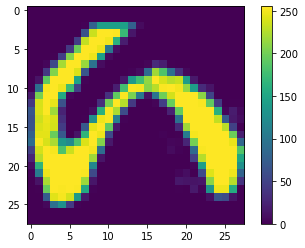

In [12]:
# View an image

df_train.loc[df_train['label'] == 1].iloc[0]
x = df_train.loc[df_train['label'] == 1].iloc[0].to_numpy()
plt.imshow(x[1:,].reshape(28,28))
plt.colorbar()

In [13]:
# Unique class labels

labels = list(df_train['label'].unique())
labels.sort()

print(labels)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48]


In [14]:
# Check for blank images by summing pixels

df_train["sum"] = df_train.sum(axis=1)
df_test["sum"] = df_test.sum(axis=1)

print(df_train["sum"].min(axis=0),df_train["sum"].min(axis=0)) # empty images are present

0 0


In [15]:
df_empty_train = df_train[df_train["sum"] < 100]
df_empty_test = df_test[df_test["sum"] < 100]

In [16]:
# Drop empties
df_train = df_train.loc[df_train["sum"] > 100]
df_test = df_test.loc[df_test["sum"] > 100]

# Drop sum
df_train = df_train.loc[:, df_train.columns != 'sum']
df_test = df_test.loc[:, df_test.columns != 'sum']
df_empty_train = df_empty_train.loc[:, df_empty_train.columns != 'sum']

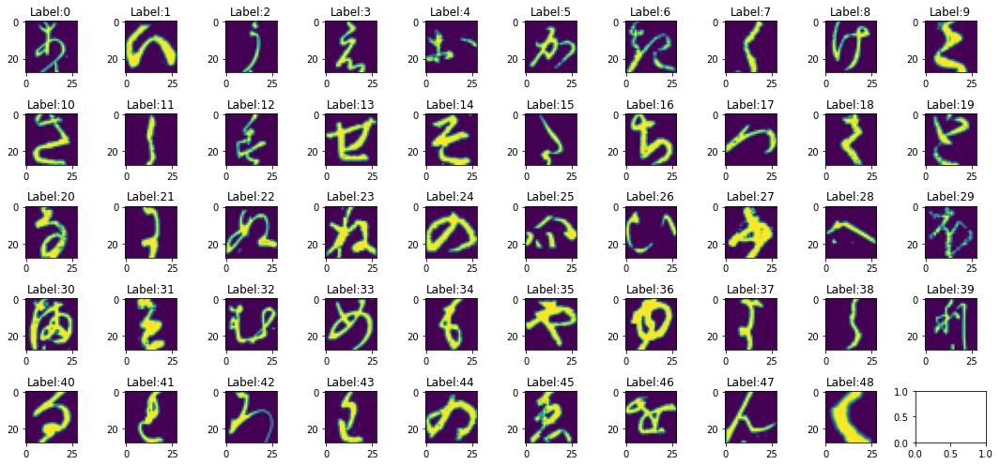

In [17]:
# View a sample of each class label

fig, axs = plt.subplots(5, 10, figsize=(15, 7))

labels = list(df_train['label'].unique())
labels.sort()
col = 0
row = 0

for label in labels:
    x = df_train.loc[df_train['label'] == label].iloc[0].to_numpy()
    axs[row, col].imshow(x[1:,].reshape(28,28))
    axs[row, col].set_title('Label:' +str(label))
                            
    col += 1
                            
    if col % 10 == 0:
        col = 0
        row +=1

fig.tight_layout()

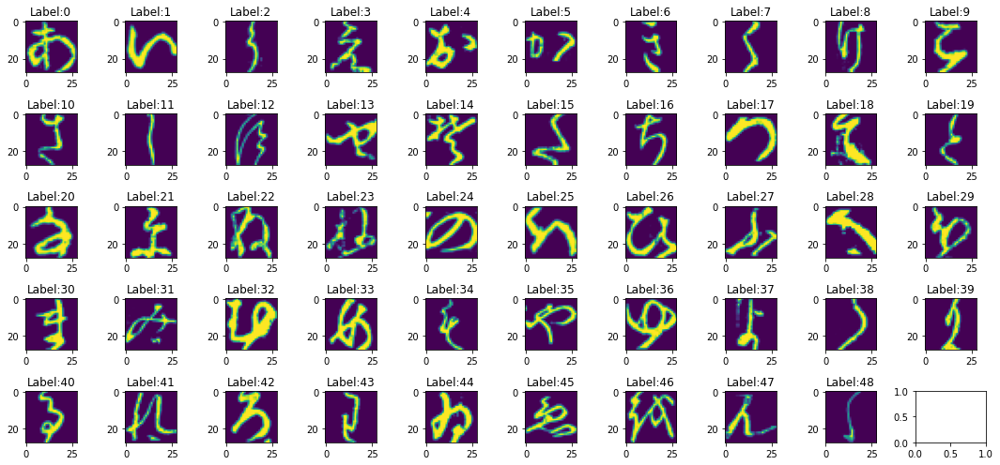

In [18]:
fig, axs = plt.subplots(5, 10, figsize=(15, 7))
#plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1.5, wspace=0.4)

labels = list(df_train['label'].unique())
labels.sort()
col = 0
row = 0

for label in labels:
    x = df_train.loc[df_train['label'] == label].iloc[1].to_numpy()
    axs[row, col].imshow(x[1:,].reshape(28,28))
    axs[row, col].set_title('Label:' +str(label))
                            
    col += 1
                            
    if col % 10 == 0:
        col = 0
        row +=1

fig.tight_layout()

**We observe several instances where characters with the same label are written differently (5, 12, 46, etc...)**

Our goal: Use unsupervised machine learning to identify and separate these.

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


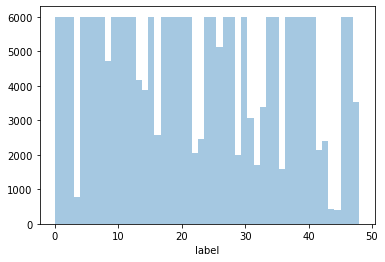

In [19]:
# Histogram of class label freq.

import seaborn as sns
g = sns.distplot(df_train['label'], kde=False, bins=49)

In [20]:
# 3, 44, 45 very infrequent

label_frq = df_train['label'].value_counts()
label_frq[30:]

47    5991
26    5128
8     4708
13    4164
14    3867
48    3521
33    3392
31    3058
16    2564
23    2451
43    2396
42    2139
22    2063
29    1993
32    1718
36    1598
3      777
44     417
45     392
Name: label, dtype: int64

In [21]:
# Assign class labels as 'categories'

df_train['label'] = df_train['label'].astype('category')
df_test['label'] = df_test['label'].astype('category')

In [22]:
df_train['label'].dtypes

CategoricalDtype(categories=[ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14,
                  15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
                  30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44,
                  45, 46, 47, 48],
                 ordered=False)

**Identifying Hentaigana using clustering**

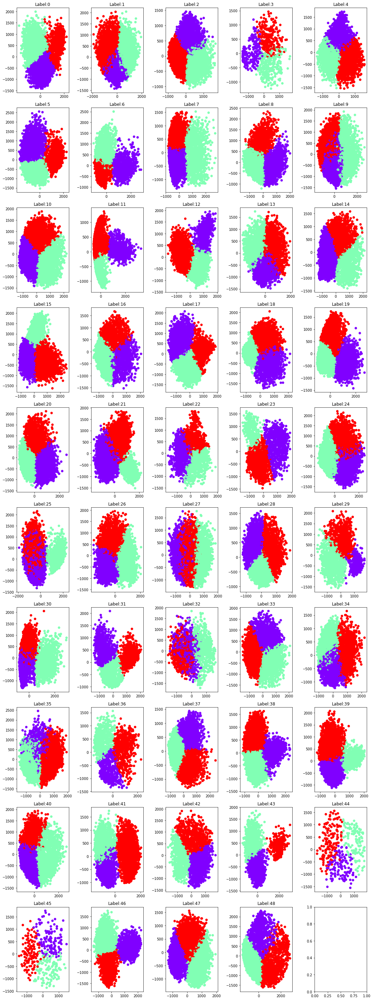

In [32]:
# Kmeans on every label
from sklearn.cluster import KMeans
from sklearn import decomposition
import seaborn as sns

from sklearn.decomposition import PCA

fig, axs = plt.subplots(10, 5, figsize=(15, 40))


labels = list(df_train['label'].unique())
labels.sort()
ykm = np.zeros(49)
i = 0
row = 0
col = 0

pca = PCA(n_components=2)

for label in labels:
    km = KMeans(n_clusters = 3)
    x = df_train.loc[df_train['label'] == label].to_numpy()
    xpca = pca.fit_transform(x)
    ykm = km.fit_predict(x)
    axs[row,col].scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
    axs[row, col].set_title('Label:' +str(label))
    i+=1
                                
    col += 1
                            
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

More investigation required:

 - homogenous solids may indicate only one writting style: need to confirm
 - several candidates for multiple writting styles are present

**Label 0**

Text(0.5, 1.0, 'Label:0')

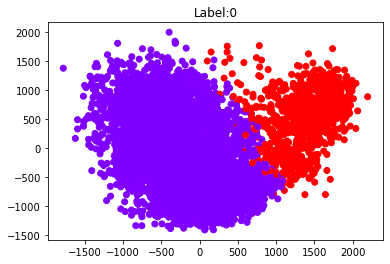

In [35]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 0].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(0))

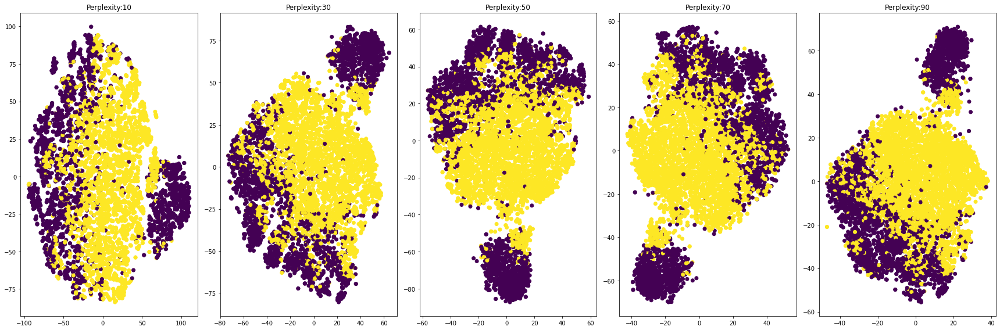

In [62]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 0].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

# To see how gaussian mixture clusters agree with TSNE
gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

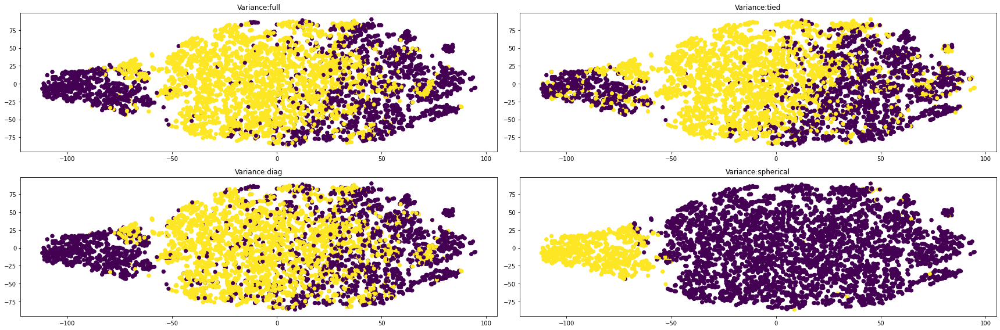

In [75]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 0].to_numpy() # next try on PCA

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 10, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, max_iter = 1000, tol = 1e-5, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'gaussian')

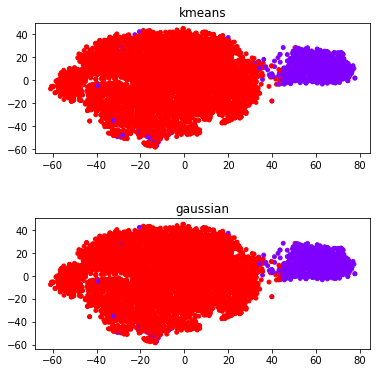

In [94]:
import hdbscan
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 0].to_numpy()

km = KMeans(n_clusters = 2, n_init = 50, max_iter = 1000, tol = 1e-7)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'spherical', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow',s=15)
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


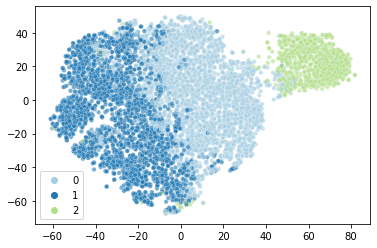

In [157]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 0].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 50, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

km = KMeans(n_clusters = 3, tol=1e-5, max_iter=1000, n_init = 50,random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


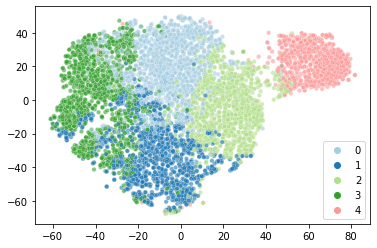

In [171]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns

km = KMeans(n_clusters = 5, tol=1e-5, max_iter=1000, n_init = 50,random_state=419)
x = df_train.loc[df_train['label'] == 0].to_numpy()[:,1:785]
ykm = km.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


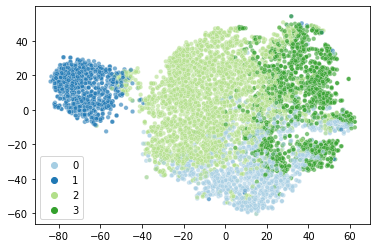

In [153]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns

x = df_train.loc[df_train['label'] == 0].to_numpy()[:,1:785]
gm = GaussianMixture(n_components = 4, covariance_type = 'full', max_iter = 1000, tol = 1e-6, n_init = 50,random_state=419)
ygm = gm.fit_predict(x)

sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ygm, alpha=0.6,palette='Paired', s=20)
plt.legend()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


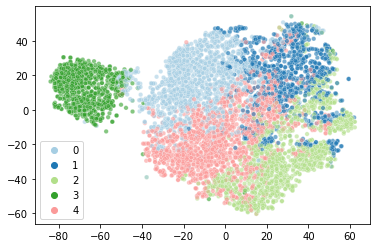

In [154]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns

x = df_train.loc[df_train['label'] == 0].to_numpy()[:,1:785]
gm = GaussianMixture(n_components = 5, covariance_type = 'full', max_iter = 1000, tol = 1e-6, n_init = 50,random_state=419)
ygm = gm.fit_predict(x)

sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ygm, alpha=0.6,palette='Paired', s=20)
plt.legend()

In [166]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_0 = df_train.loc[df_train['label'] == 0].copy(deep=True)
df_train_0["Style"] = 0

x = df_train_0.loc[df_train_0['label'] == 0].to_numpy()[:,1:785]

km = KMeans(n_clusters = 3, tol=1e-5, max_iter=1000, n_init = 50,random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 2 else 1 for i in ykm]

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


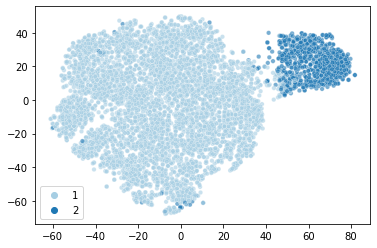

In [164]:
sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

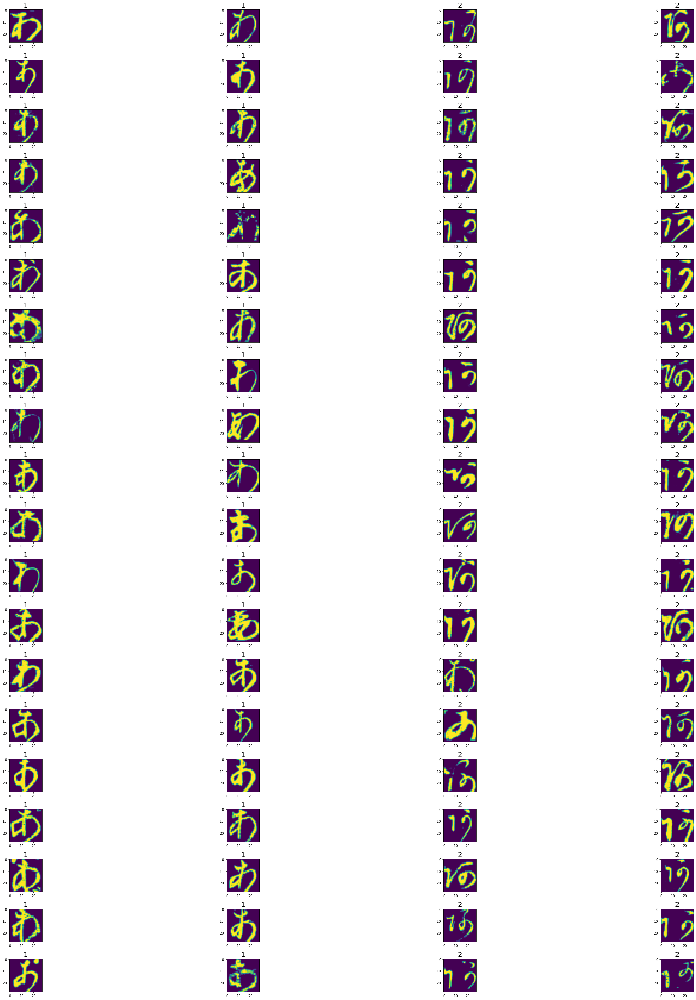

In [167]:
df_train_0.loc[df_train_0['label'] == 0, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_0.loc[df_train_0['Style'] == 1].iloc[40:80].to_numpy()
label1 = df_train_0.loc[df_train_0['Style'] == 2].iloc[40:80].to_numpy()



for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        

fig.tight_layout()

It's difficult to see, but there appear to be two distinct styles for this character.

**Label 3**

Text(0.5, 1.0, 'Label:3')

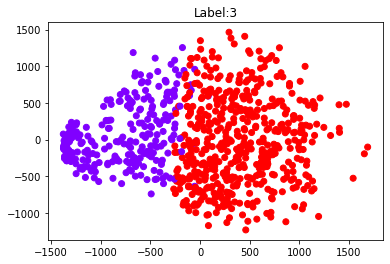

In [37]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 3].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(3))

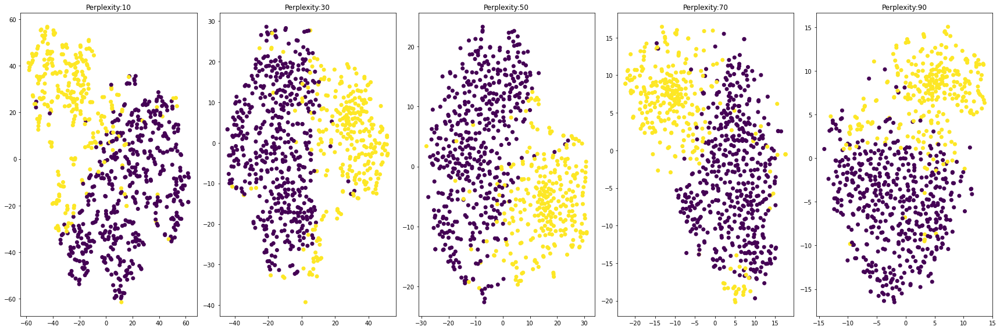

In [61]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 3].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

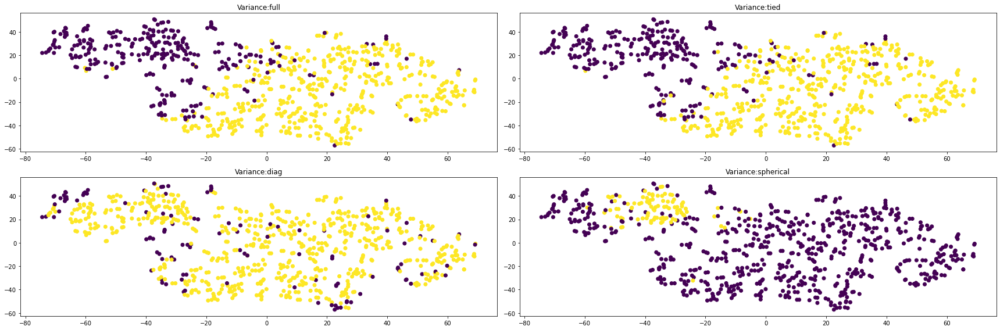

In [82]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 3].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 10, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, tol=1e-5, max_iter = 1000, n_init = 50)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'gaussian')

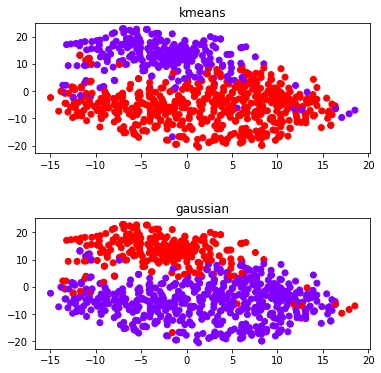

In [86]:
import hdbscan
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 3].to_numpy()

km = KMeans(n_clusters = 2)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 10)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow')
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow')
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

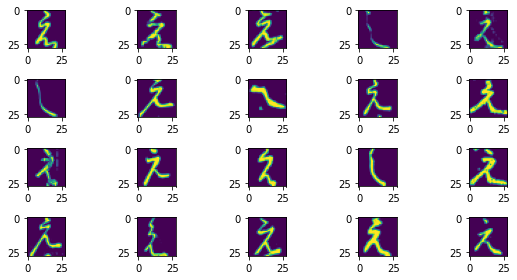

In [38]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 3].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

**Label 5**

Text(0.5, 1.0, 'Label:5')

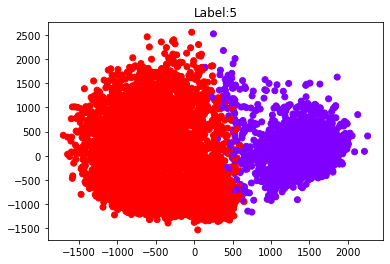

In [39]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 5].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(5))

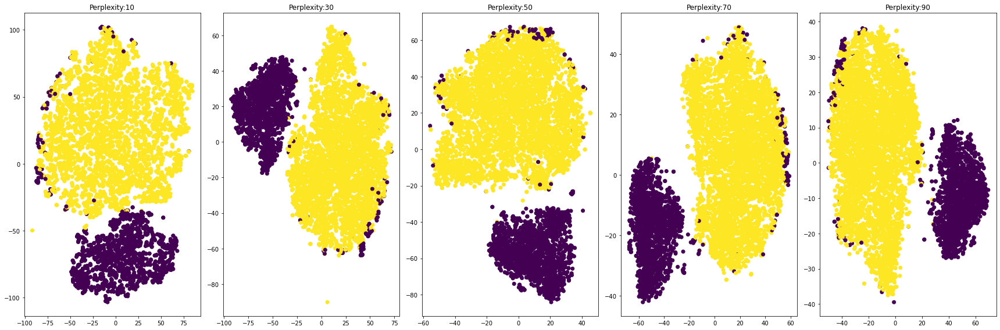

In [63]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 5].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

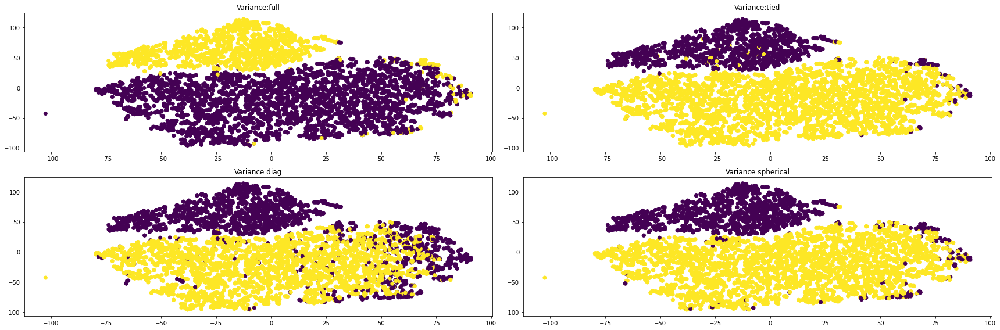

In [74]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 5].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 10, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, tol=1e-5,max_iter = 1000, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'gaussian')

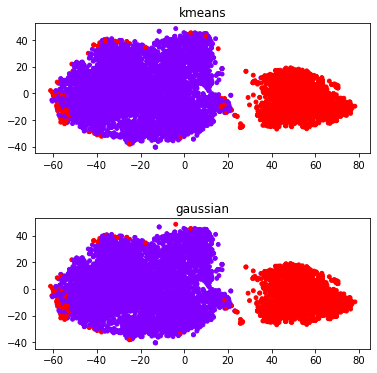

In [92]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 5].to_numpy()

km = KMeans(n_clusters = 2, n_init = 50, max_iter = 1000, tol = 1e-7)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'full', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow', s=15)
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow', s=15)
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

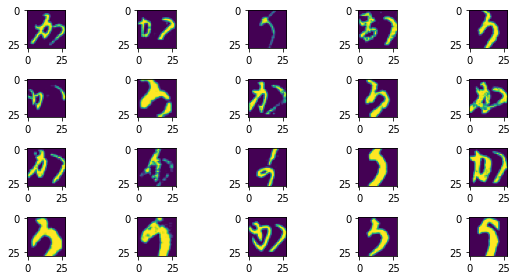

In [40]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 5].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


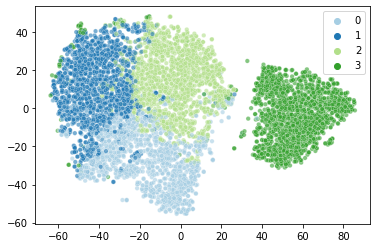

In [173]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 5].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 50, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

km = KMeans(n_clusters = 4, tol=1e-5, max_iter=1000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


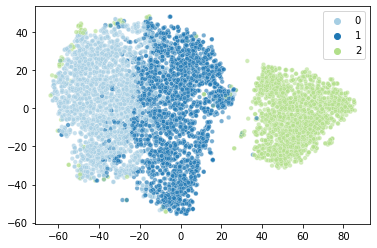

In [178]:
km_new = KMeans(n_clusters = 3, tol=1e-5, max_iter=1000, n_init = 50, random_state=419)
ykm_new = km_new.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm_new, alpha=0.6,palette='Paired', s=20)
plt.legend()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


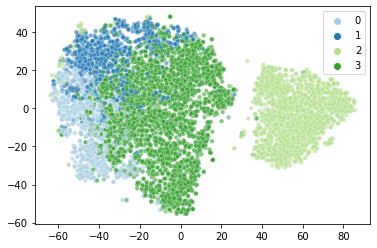

In [182]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns

gm = GaussianMixture(n_components = 4, covariance_type = 'full', n_init=10,random_state=419)
ygm = gm.fit_predict(x)

sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ygm, alpha=0.6,palette='Paired', s=20)
plt.legend()

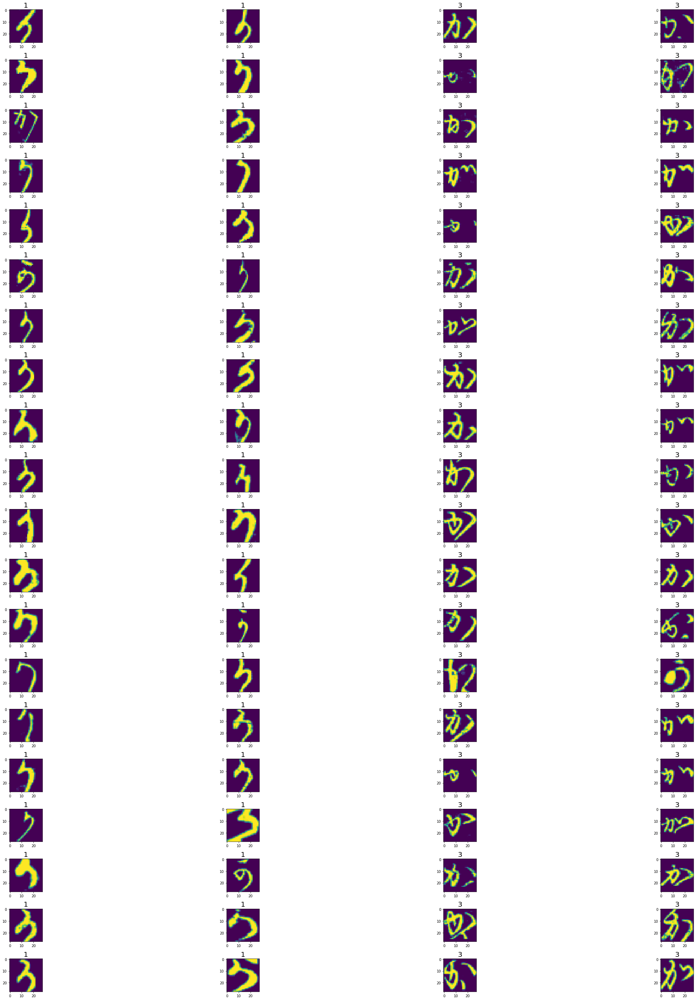

In [175]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_5 = df_train.loc[df_train['label'] == 5].copy(deep=True)
df_train_5["Style"] = 0

x = df_train_5.loc[df_train_5['label'] == 5].to_numpy()[:,1:785]

km = KMeans(n_clusters = 4, tol=1e-5, max_iter=1000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 3 else 1 for i in ykm]

df_train_5.loc[df_train_5['label'] == 5, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_5.loc[df_train_5['Style'] == 1].iloc[40:80].to_numpy()
label1 = df_train_5.loc[df_train_5['Style'] == 3].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        

fig.tight_layout()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


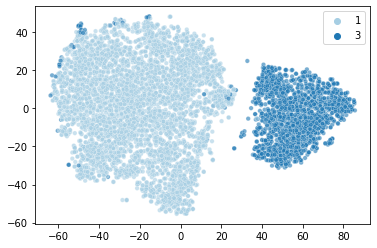

In [176]:
sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

**Label 12**

Text(0.5, 1.0, 'Label:12')

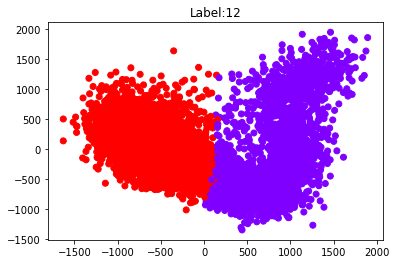

In [28]:
from sklearn import decomposition
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# label 12 with kmeans

pca = PCA(n_components=2)

km = KMeans(n_clusters = 2,max_iter = 1000, tol = 1e-7)
x = df_train.loc[df_train['label'] == 12].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(12))

Text(0.5, 1.0, 'Label:12')

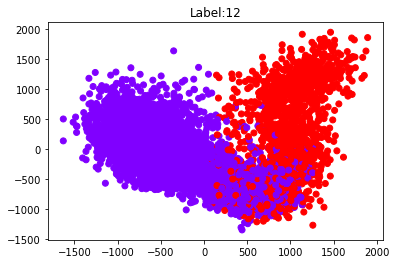

In [29]:
from sklearn import decomposition
import seaborn as sns
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA

# label 12 with gaussian mix

pca = PCA(n_components=2)

km = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
x = df_train.loc[df_train['label'] == 12].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(12))

[t-SNE] Computing 106 nearest neighbors...
[t-SNE] Indexed 5998 samples in 1.458s...
[t-SNE] Computed neighbors for 5998 samples in 17.183s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5998
[t-SNE] Computed conditional probabilities for sample 2000 / 5998
[t-SNE] Computed conditional probabilities for sample 3000 / 5998
[t-SNE] Computed conditional probabilities for sample 4000 / 5998
[t-SNE] Computed conditional probabilities for sample 5000 / 5998
[t-SNE] Computed conditional probabilities for sample 5998 / 5998
[t-SNE] Mean sigma: 525.196779
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.648834
[t-SNE] KL divergence after 5000 iterations: 1.709316


Text(0.5, 1.0, 'Label:12')

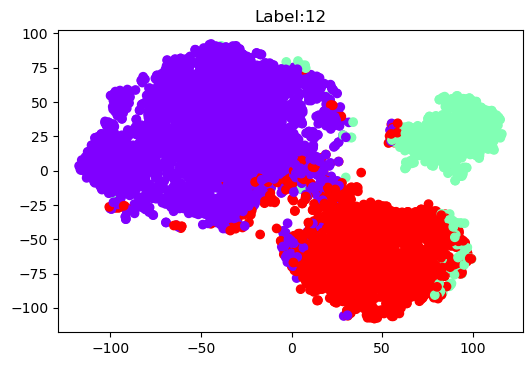

In [30]:
from sklearn import decomposition
import seaborn as sns
from sklearn.manifold import TSNE

# label 12 with tsne + kmeans

tsne = TSNE(n_jobs = -1, perplexity = 35, verbose = 1, n_iter=5000)

figure = plt.figure(dpi=100)

km = KMeans(n_clusters = 3)

x = df_train.loc[df_train['label'] == 12].to_numpy()
X_tsne = tsne.fit_transform(x)

ykm = km.fit_predict(x)
plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(12))

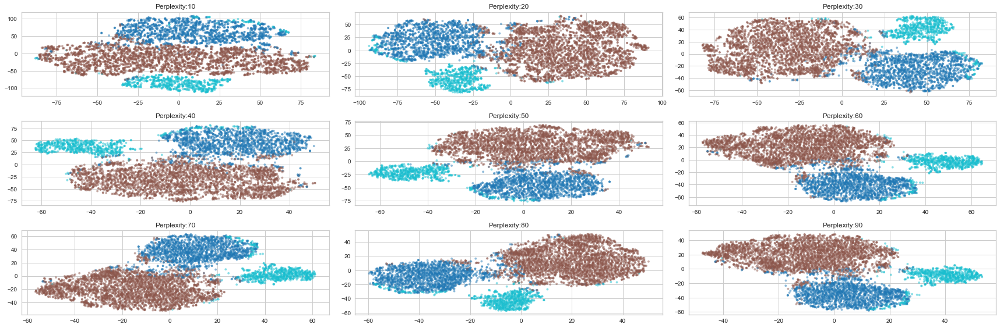

In [91]:
# test several perplexities on label w/o dimension reduction
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(3, 3, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 12].to_numpy() # next try on PCA

perp = [10,20,30,40,50,60,70,80,90]
col = 0
row = 0

km = KMeans(n_clusters = 3, max_iter = 1000, init = 'random', tol = 1e-6)
ykm = km.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row ,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ykm, s=15, edgecolor='none', alpha=0.5,cmap=plt.cm.get_cmap('tab10', 10))
    axs[row, col].set_title('Perplexity:' +str(plx))
                                
    col += 1                       
    if col % 3 == 0:
        col = 0
        row +=1


fig.tight_layout()

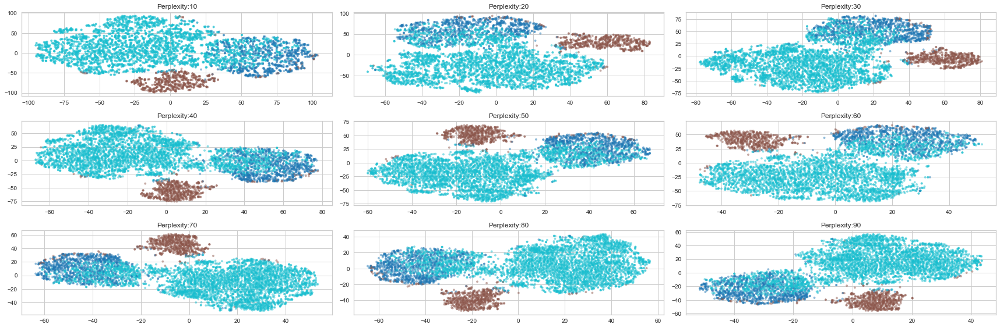

In [92]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(3, 3, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 12].to_numpy() # next try on PCA

perp = [10,20,30,40,50,60,70,80,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 3,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row ,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm, s=15, edgecolor='none', alpha=0.5,cmap=plt.cm.get_cmap('tab10', 10))
    axs[row, col].set_title('Perplexity:' +str(plx))
                                
    col += 1                       
    if col % 3 == 0:
        col = 0
        row +=1


fig.tight_layout()

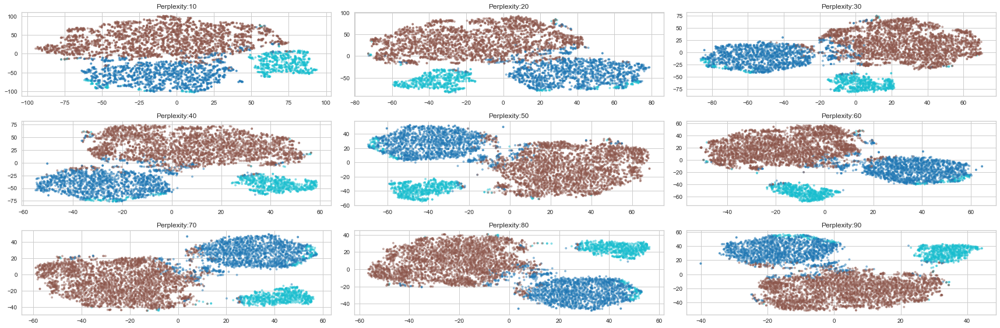

In [90]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(3, 3, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 12].to_numpy() # next try on PCA

perp = [10,20,30,40,50,60,70,80,90]
col = 0
row = 0

pca = PCA(n_components=0.7)
xpca = pca.fit_transform(x)

km = KMeans(n_clusters = 3)
ykm = km.fit_predict(xpca)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(xpca) 
    

    axs[row ,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ykm, s=15, edgecolor='none', alpha=0.5,cmap=plt.cm.get_cmap('tab10', 10))
    axs[row, col].set_title('Perplexity:' +str(plx))
                                
    col += 1                       
    if col % 3 == 0:
        col = 0
        row +=1


fig.tight_layout()

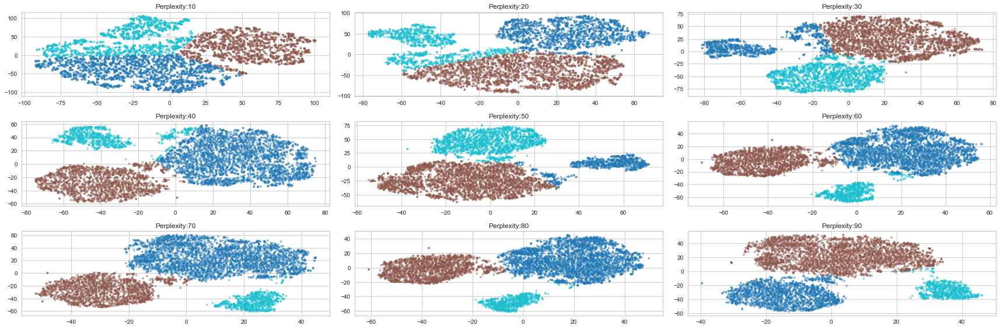

In [88]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(3, 3, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 12].to_numpy() # next try on PCA
km = KMeans(n_clusters = 2)

perp = [10,20,30,40,50,60,70,80,90]
col = 0
row = 0

pca = PCA(n_components=0.7)
xpca = pca.fit_transform(x)

km = KMeans(n_clusters = 3)
ykm = km.fit_predict(xpca)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(xpca) 
    ykm = km.fit_predict(X_tsne)

    axs[row ,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ykm, s=15, edgecolor='none', alpha=0.5,cmap=plt.cm.get_cmap('tab10', 10))
    axs[row, col].set_title('Perplexity:' +str(plx))
                                
    col += 1                       
    if col % 3 == 0:
        col = 0
        row +=1


fig.tight_layout()

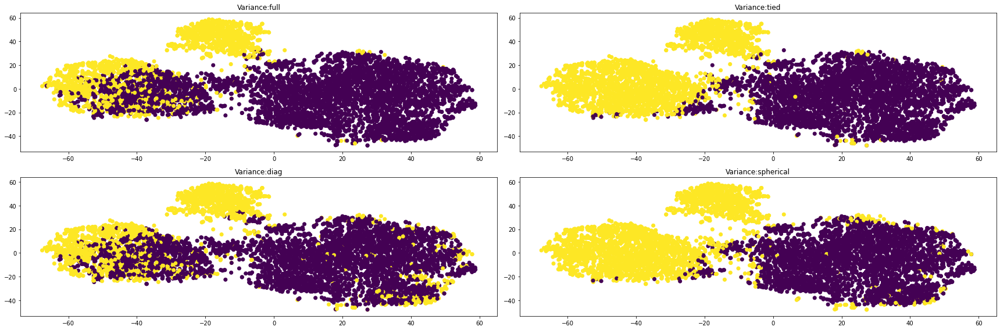

In [73]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 12].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

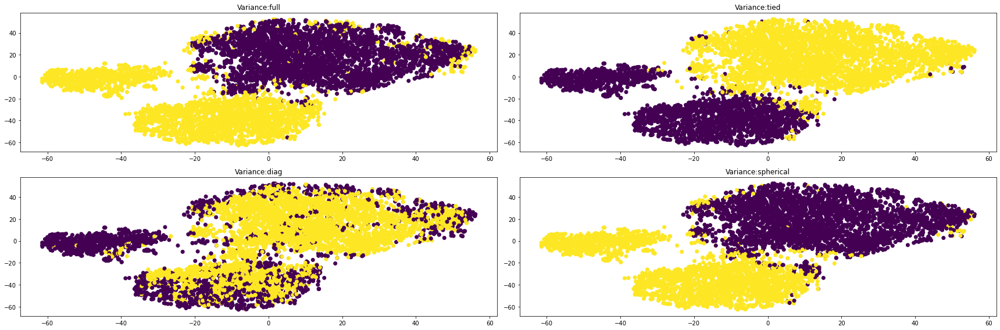

In [72]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 12].to_numpy() # next try on PCA

pca = PCA(n_components=0.8)
xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(xpca)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

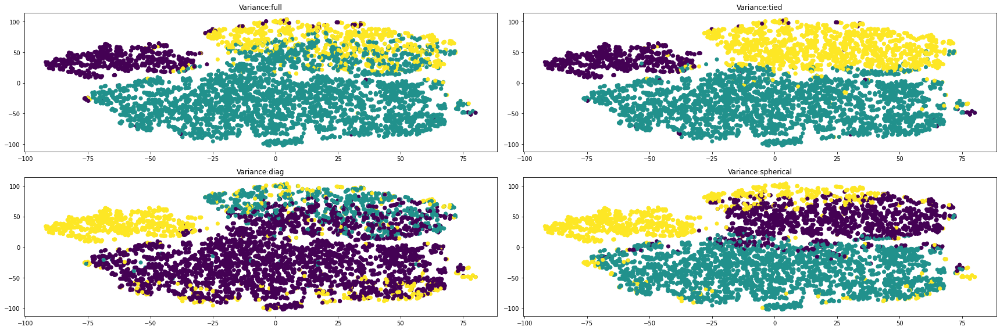

In [89]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 12].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 10, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 3, covariance_type = v, tol=1e-5,max_iter = 1000, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'gaussian')

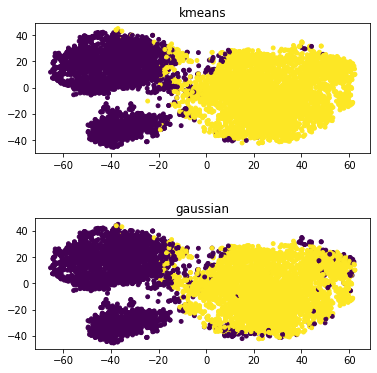

In [95]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 12].to_numpy()

km = KMeans(n_clusters = 2, n_init = 50, max_iter = 1000, tol = 1e-7)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'spherical', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,s=15)
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,s=15)
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

Text(0.5, 1.0, 'gaussian')

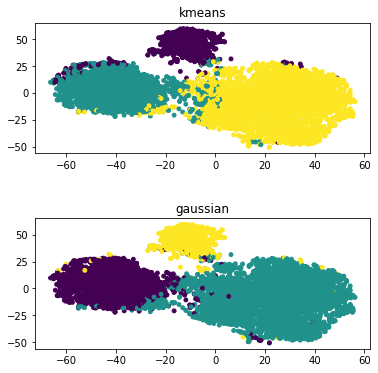

In [96]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 12].to_numpy()

km = KMeans(n_clusters = 3, n_init = 50, max_iter = 1000, tol = 1e-7)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 3, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,s=15)
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,s=15)
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

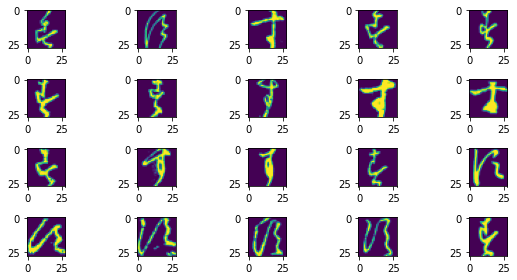

In [82]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 12].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

In [183]:

x = df_train.loc[df_train['label'] == 12].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


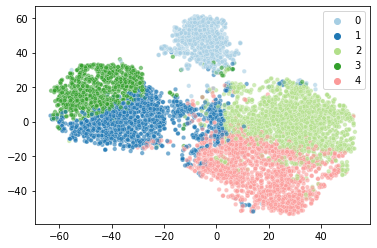

In [191]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 12].to_numpy()[:,1:785]

km = KMeans(n_clusters = 5, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

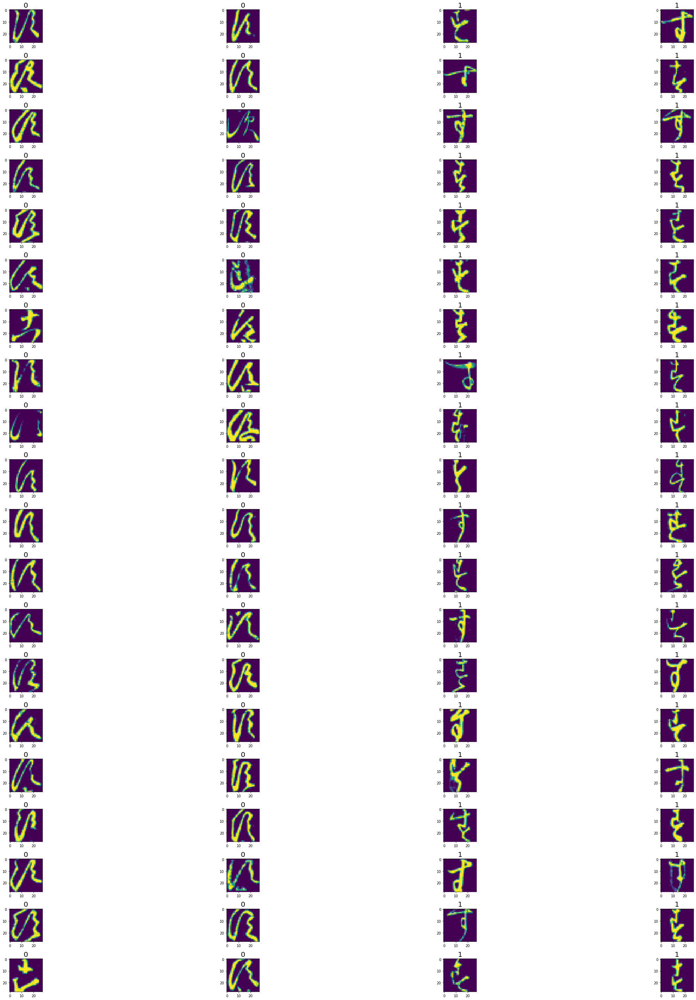

In [192]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_12 = df_train.loc[df_train['label'] == 12].copy(deep=True)
df_train_12["Style"] = 0

x = df_train_12.loc[df_train_12['label'] == 12].to_numpy()[:,1:785]

km = KMeans(n_clusters = 5, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 0 else 1 for i in ykm]

df_train_12.loc[df_train_12['label'] == 12, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_12.loc[df_train_12['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_12.loc[df_train_12['Style'] == 1].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        

fig.tight_layout()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


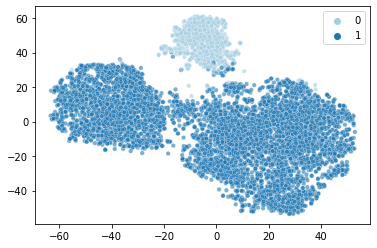

In [193]:
sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

**Label 14**

Text(0.5, 1.0, 'Label:14')

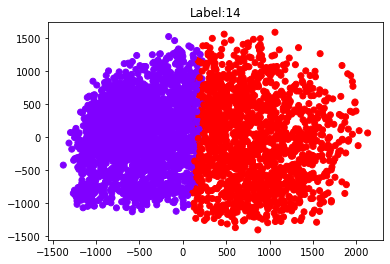

In [43]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 14].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(14))

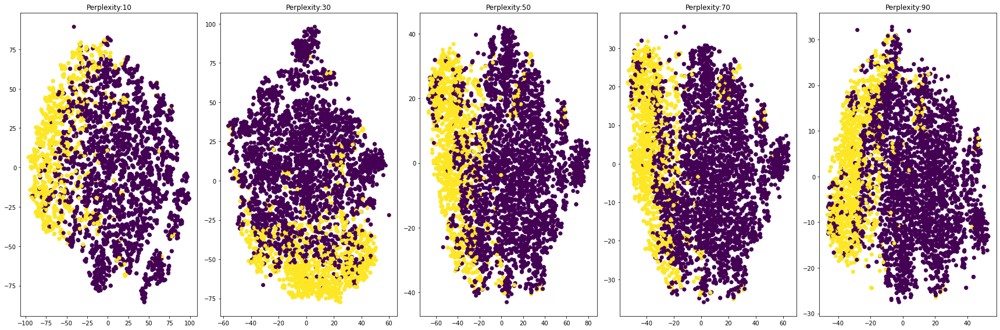

In [64]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 14].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

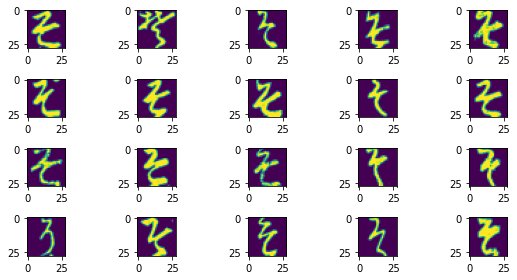

In [44]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 14].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

**Label 19**

Text(0.5, 1.0, 'Label:19')

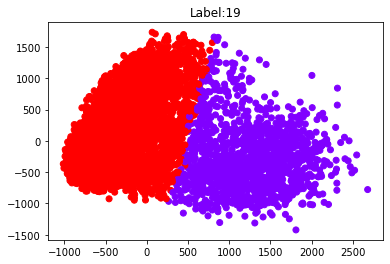

In [45]:
pca = P**Label 5**CA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 19].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(19))

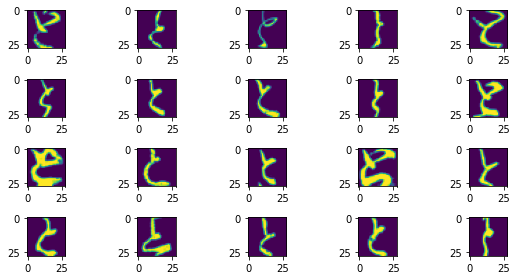

In [46]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 19].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

In [195]:

x = df_train.loc[df_train['label'] == 19].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


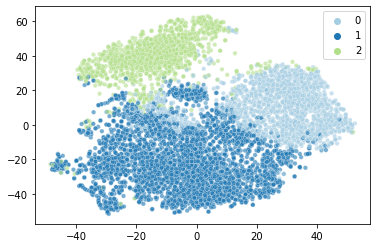

In [198]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 19].to_numpy()[:,1:785]

km = KMeans(n_clusters = 3, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

**Label 21**

Text(0.5, 1.0, 'Label:21')

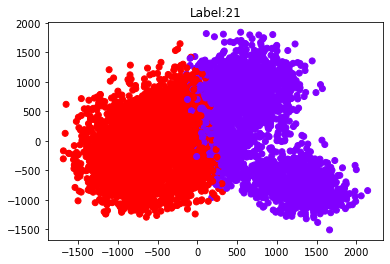

In [83]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 21].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(21))

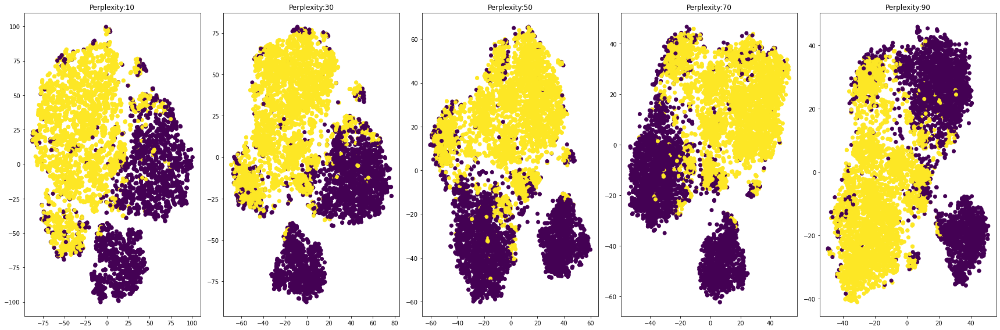

In [65]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 21].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

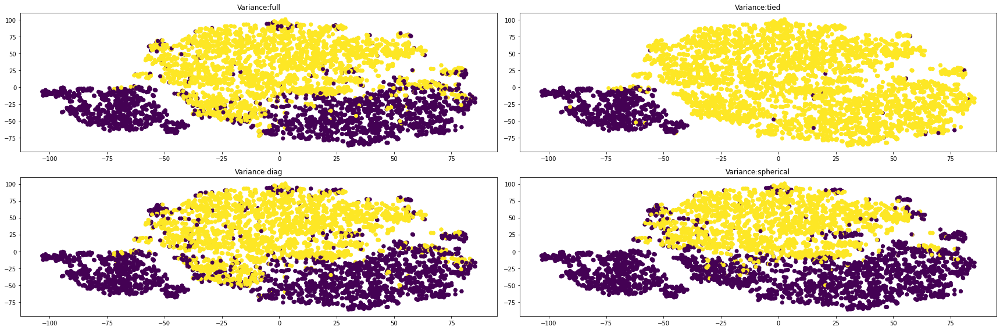

In [71]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 21].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 10, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

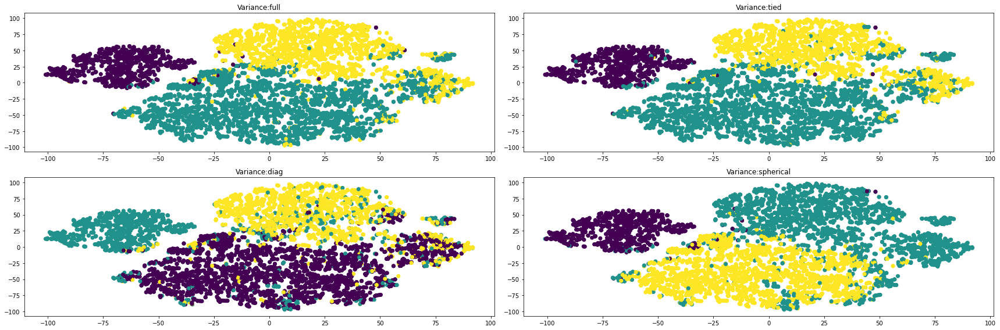

In [70]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 21].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 10, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 3, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

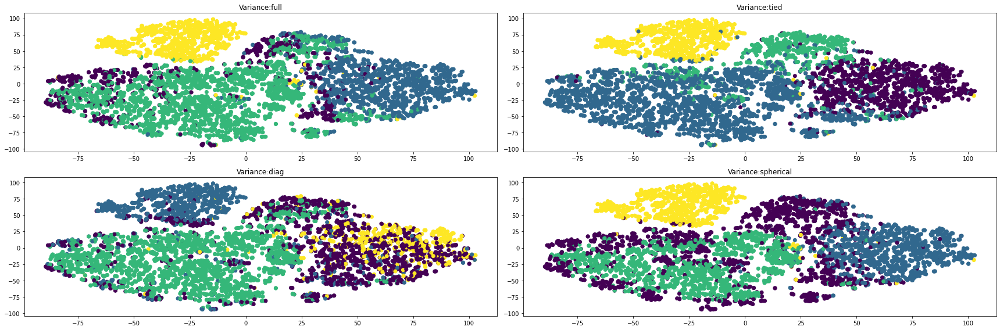

In [69]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 21].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 10, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 4, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'gaussian')

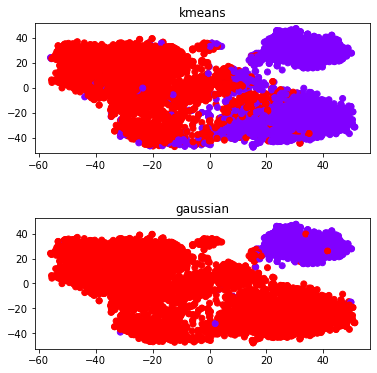

In [91]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 21].to_numpy()

km = KMeans(n_clusters = 2, n_init = 50, max_iter = 1000, tol = 1e-7)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow')
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow')
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

Text(0.5, 1.0, 'gaussian')

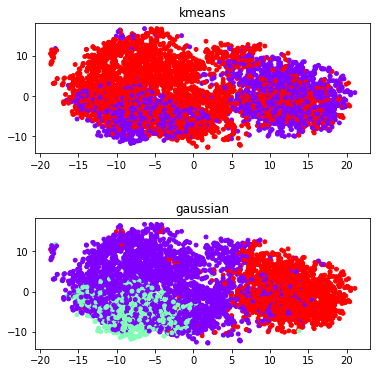

In [97]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 21].to_numpy()

km = KMeans(n_clusters = 2, n_init = 50, max_iter = 1000, tol = 1e-7)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 3, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 3, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow',s=15)
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

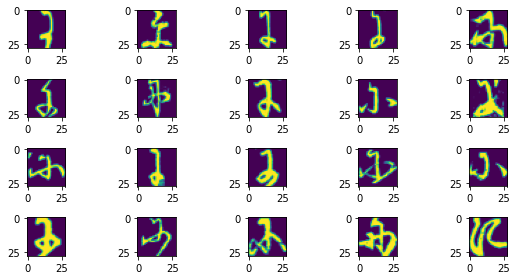

In [48]:
# FURTHER INVESTIGATION REQUIRED - THERE ARE MANNNY

fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 21].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

In [199]:

x = df_train.loc[df_train['label'] == 21].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


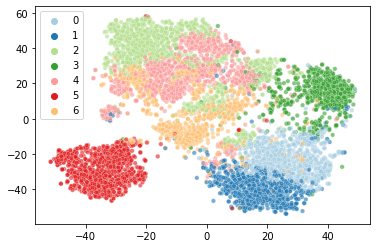

In [208]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 21].to_numpy()[:,1:785]

km = KMeans(n_clusters = 7, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

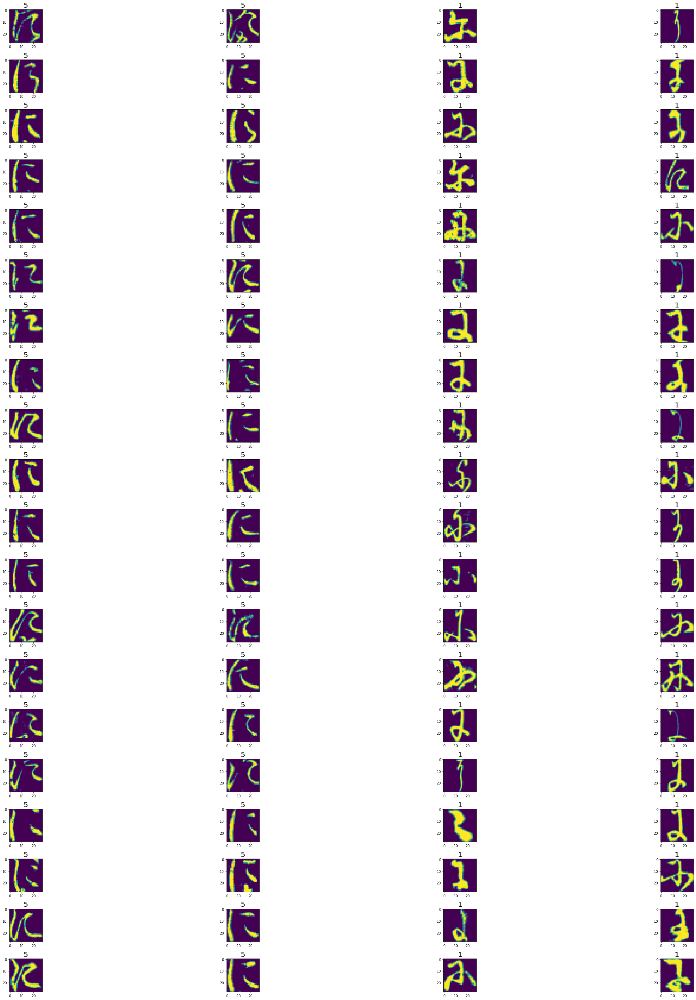

In [209]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_21 = df_train.loc[df_train['label'] == 21].copy(deep=True)
df_train_21["Style"] = 0

x = df_train_21.loc[df_train['label'] == 21].to_numpy()[:,1:785]

km = KMeans(n_clusters = 7, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 5 else 1 for i in ykm]

df_train_21.loc[df_train_21['label'] == 21, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_21.loc[df_train_21['Style'] == 5].iloc[40:80].to_numpy()
label1 = df_train_21.loc[df_train_21['Style'] == 1].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        

fig.tight_layout()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


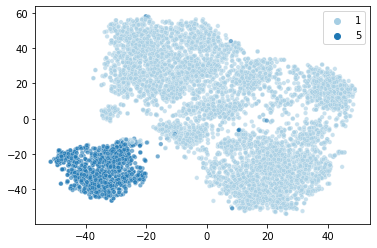

In [210]:
sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

**Label 22**

Text(0.5, 1.0, 'Label:22')

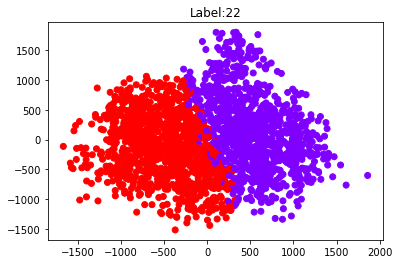

In [49]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 22].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(22))

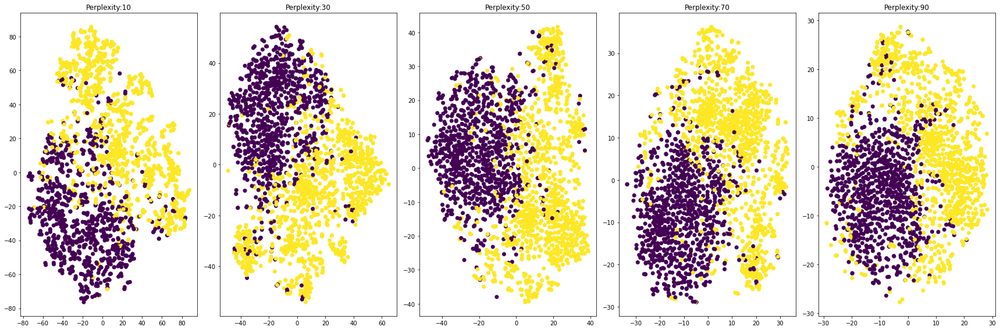

In [66]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 22].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

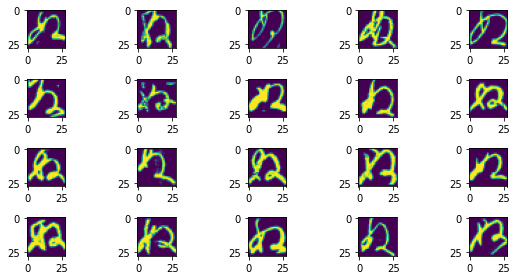

In [50]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 22].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

**Label 23**

Text(0.5, 1.0, 'Label:23')

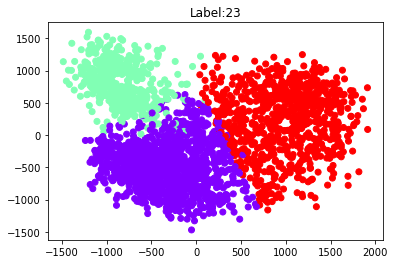

In [84]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 3)
x = df_train.loc[df_train['label'] == 23].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(23))

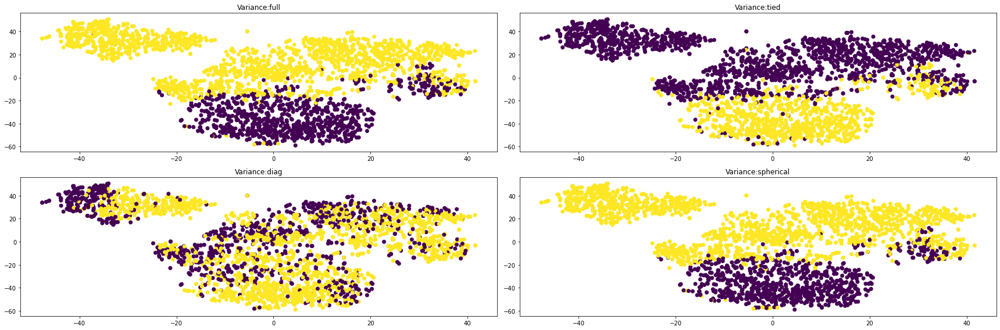

In [68]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 23].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 50, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, max_iter = 1000, tol=1e-5, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

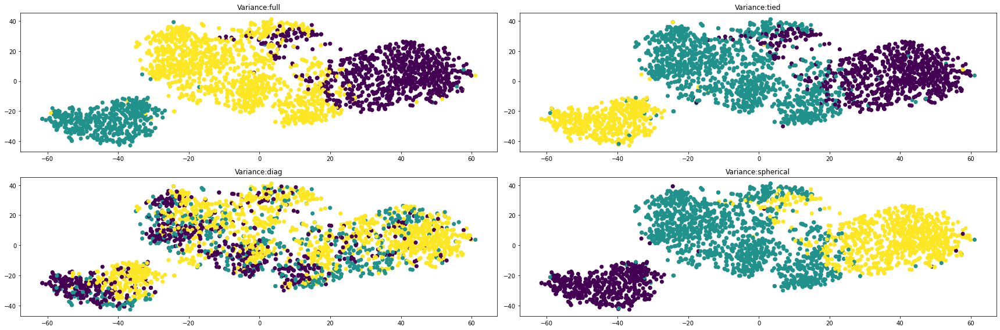

In [58]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 23].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 50, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 3, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

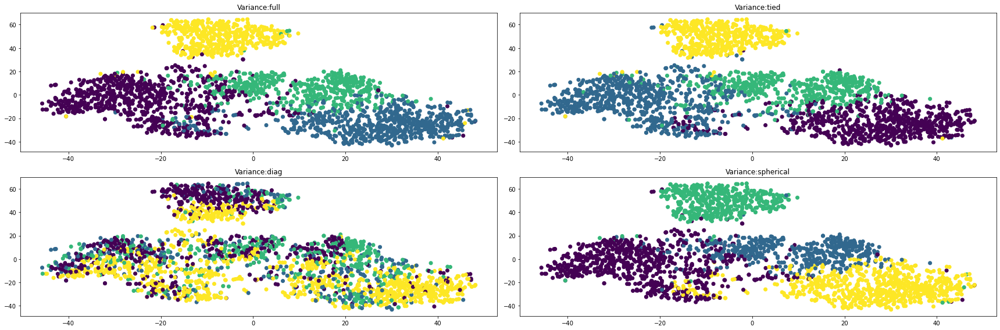

In [78]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 23].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 50, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 4, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'Label:23')

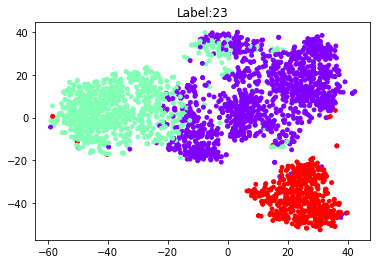

In [101]:
from sklearn.manifold import TSNE

km = KMeans(n_clusters = 3)
x = df_train.loc[df_train['label'] == 23].to_numpy()
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 50, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 
ykm = km.fit_predict(x)
plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
plt.title('Label:' +str(23))

Text(0.5, 1.0, 'Label:23')

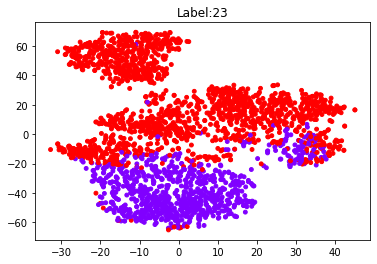

In [145]:
from sklearn.manifold import TSNE

km = KMeans(n_clusters = 2,tol=1e-5, max_iter=1000, n_init = 50)
x = df_train.loc[df_train['label'] == 23].to_numpy()

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 50, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

ykm = km.fit_predict(x)

plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
plt.title('Label:' +str(23))

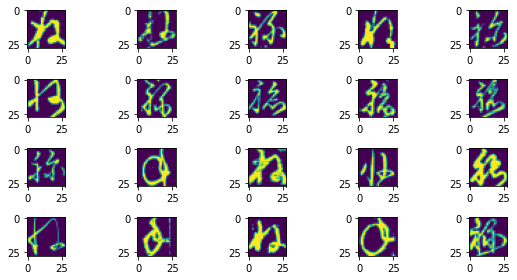

In [52]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 23].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

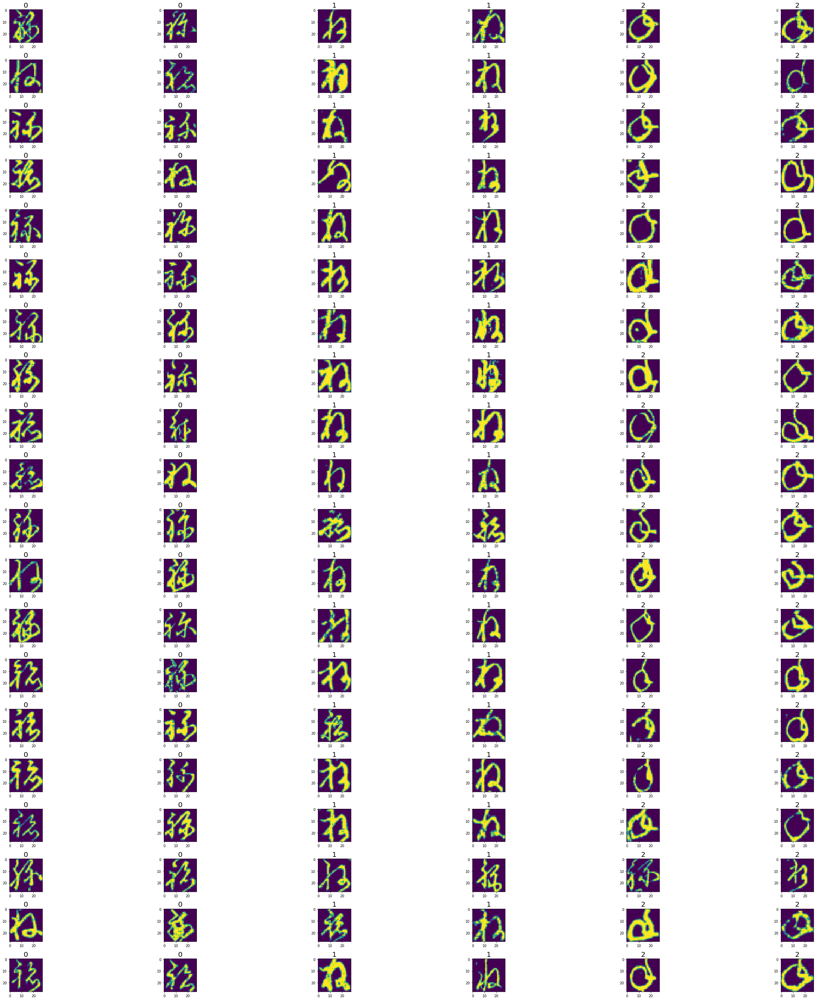

In [146]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_23 = df_train.loc[df_train['label'] == 23].copy(deep=True)
df_train_23["Style"] = 0

x = df_train_23.loc[df_train_23['label'] == 23].to_numpy()[:,1:785]

km = KMeans(n_clusters = 3,tol=1e-5, max_iter=1000, n_init = 50)

ykm = km.fit_predict(x)

df_train_23.loc[df_train_23['label'] == 23, 'Style'] += ykm


fig, axs = plt.subplots(20, 6, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_23.loc[df_train_23['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_23.loc[df_train_23['Style'] == 1].iloc[40:80].to_numpy()
label2 = df_train_23.loc[df_train_23['Style'] == 2].iloc[40:80].to_numpy()



for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label2:
    axs[row, 4 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 4 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

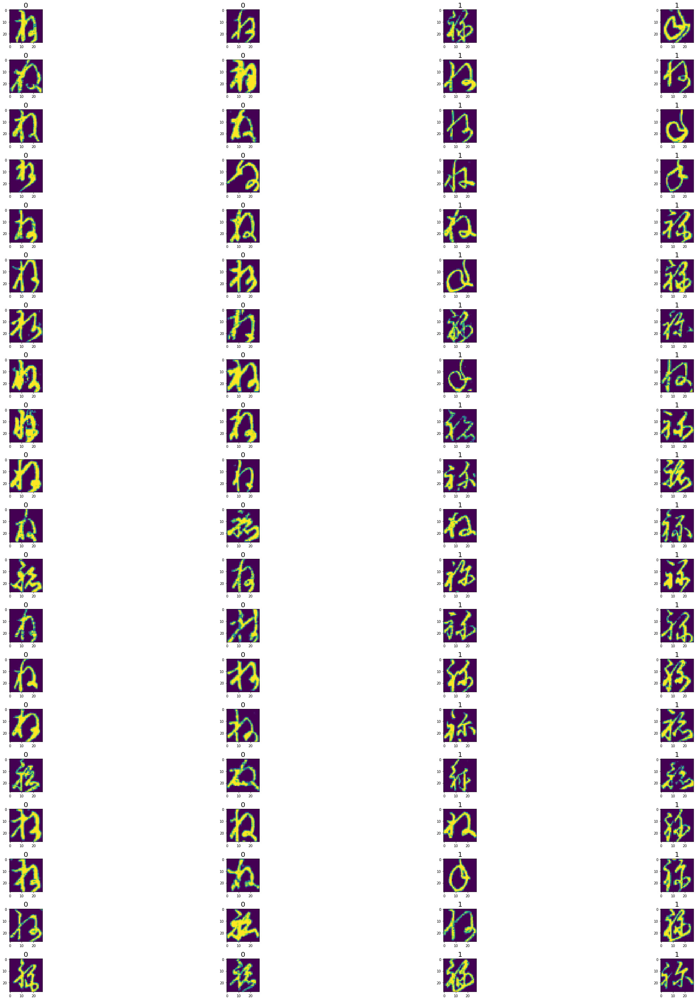

In [147]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_23 = df_train.loc[df_train['label'] == 23].copy(deep=True)
df_train_23["Style"] = 0

x = df_train_23.loc[df_train_23['label'] == 23].to_numpy()[:,1:785]

km = KMeans(n_clusters = 2,tol=1e-5, max_iter=1000, n_init = 50)

ykm = km.fit_predict(x)

df_train_23.loc[df_train_23['label'] == 23, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_23.loc[df_train_23['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_23.loc[df_train_23['Style'] == 1].iloc[40:80].to_numpy()
label2 = df_train_23.loc[df_train_23['Style'] == 2].iloc[40:80].to_numpy()



for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

In [211]:

x = df_train.loc[df_train['label'] == 23].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 50, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


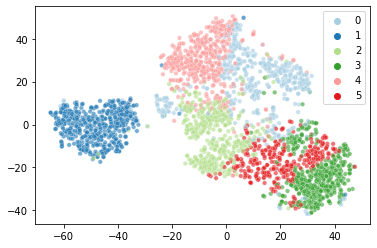

In [217]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 23].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

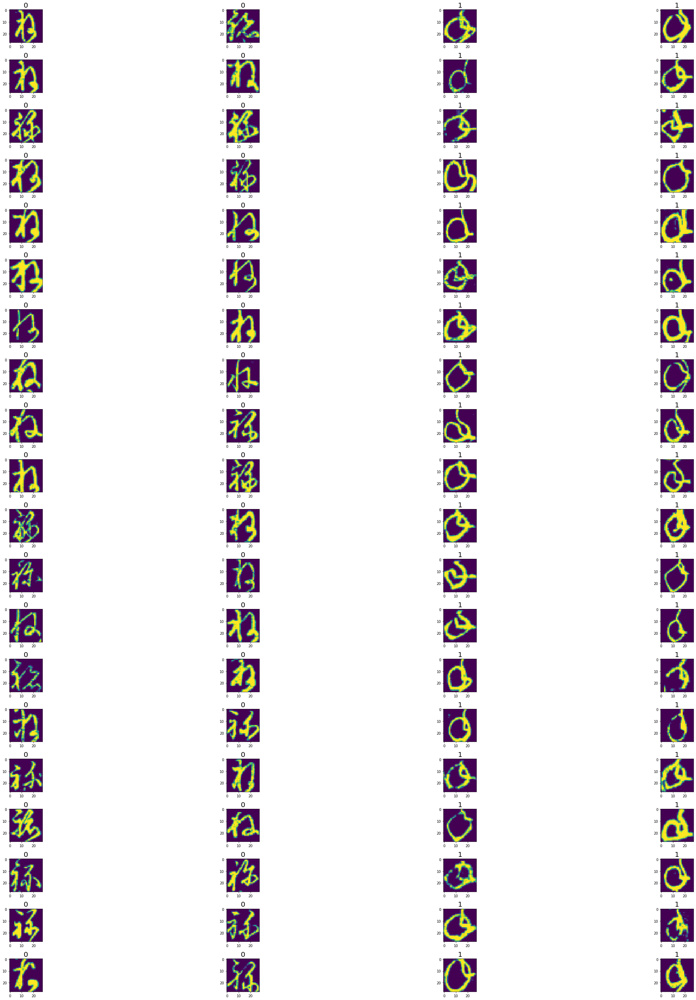

In [218]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_23 = df_train.loc[df_train['label'] == 23].copy(deep=True)
df_train_23["Style"] = 0

x = df_train_23.loc[df_train['label'] == 23].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 1 else 0 for i in ykm]

df_train_23.loc[df_train_23['label'] == 23, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_23.loc[df_train_23['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_23.loc[df_train_23['Style'] == 1].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
    
        

fig.tight_layout()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


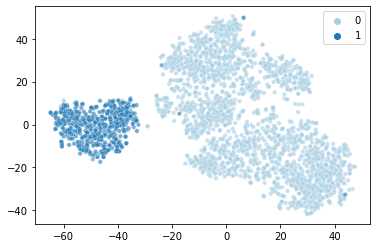

In [219]:
sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

**Label 24**

Text(0.5, 1.0, 'Label:24')

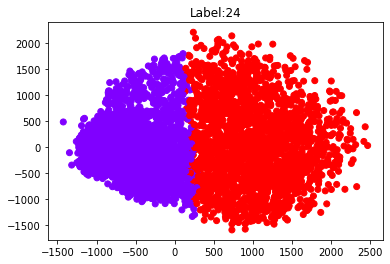

In [53]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 24].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(24))

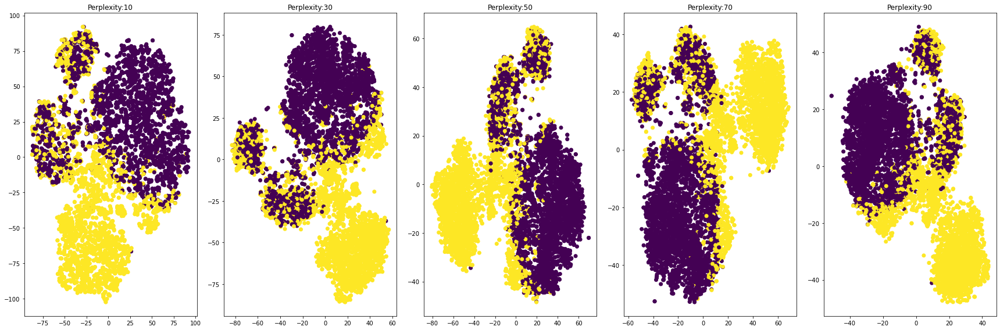

In [67]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 24].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

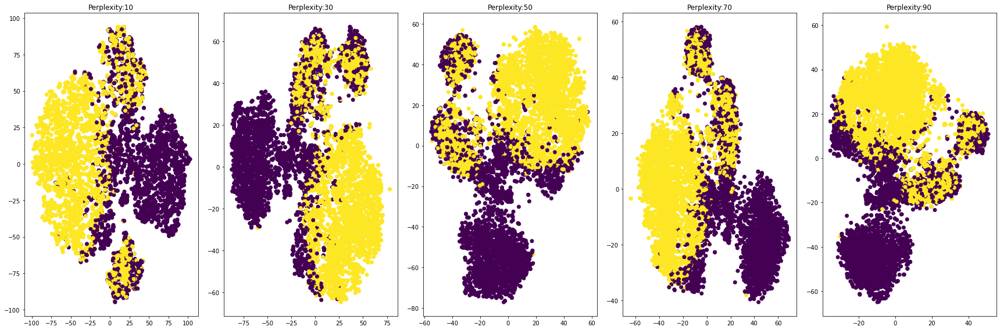

In [107]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 24].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

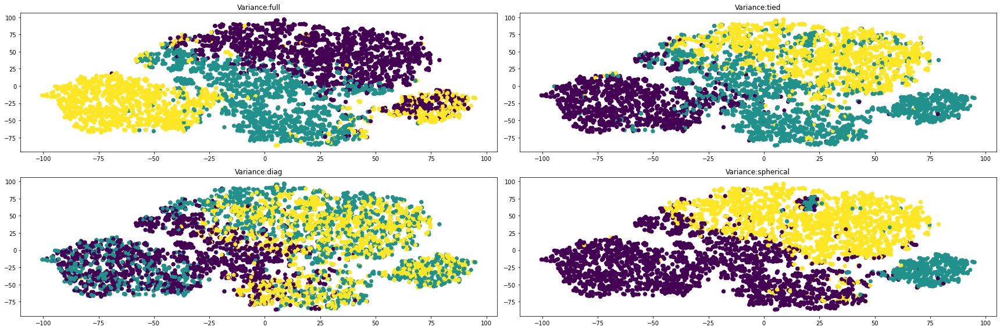

In [67]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 24].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 10, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 3, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

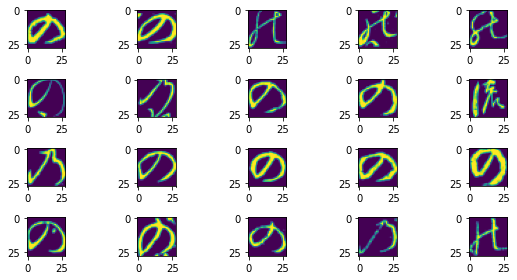

In [54]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 24].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

**Label 25**

Text(0.5, 1.0, 'Label:25')

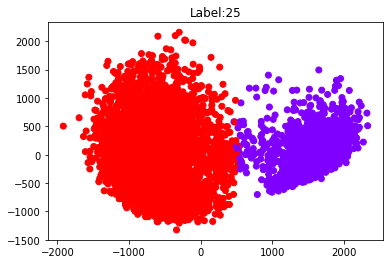

In [55]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 25].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(25))

Text(0.5, 1.0, 'Label:25')

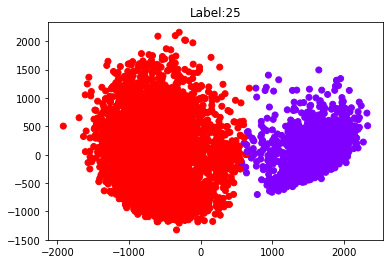

In [47]:
pca = PCA(n_components=0.7)

gm = GaussianMixture(n_components = 2, covariance_type = 'spherical', n_init = 10)
x = df_train.loc[df_train['label'] == 25].to_numpy()
xpca = pca.fit_transform(x)
ygm = gm.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ygm,cmap='rainbow')
plt.title('Label:' +str(25))

In [ ]:
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow')

Text(0.5, 1.0, 'Label:25')

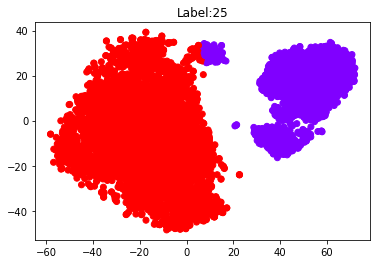

In [44]:
x = df_train.loc[df_train['label'] == 25].to_numpy()
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

km = KMeans(n_clusters = 2)
ykm = km.fit_predict(X_tsne)
plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(25))

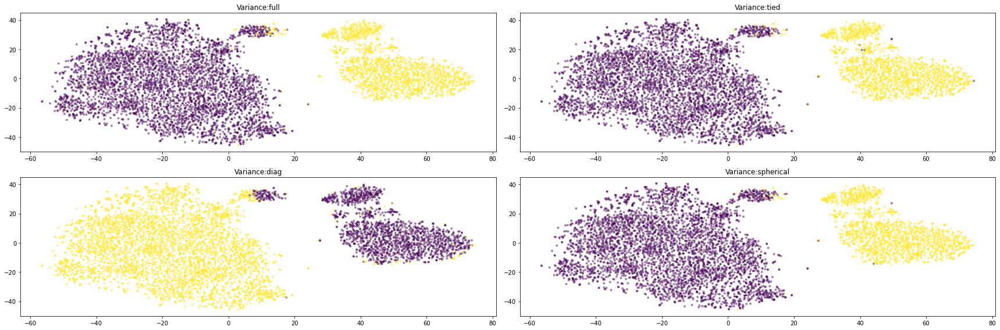

In [42]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 25].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm, s=15, edgecolor='none', alpha=0.5)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'Label:25')

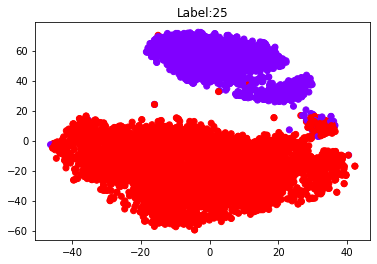

In [40]:
from sklearn.mixture import GaussianMixture

x = df_train.loc[df_train['label'] == 25].to_numpy()
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', n_init = 10)
ygm = gm.fit_predict(x)
plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow')
plt.title('Label:' +str(25))

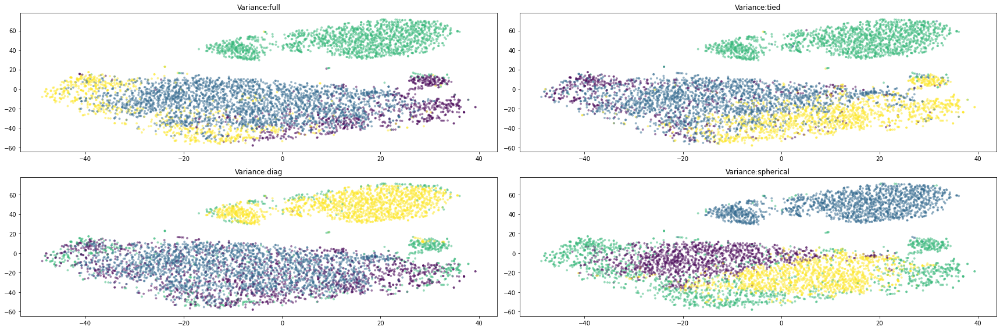

In [45]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 25].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 4, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm, s=15, edgecolor='none', alpha=0.5)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

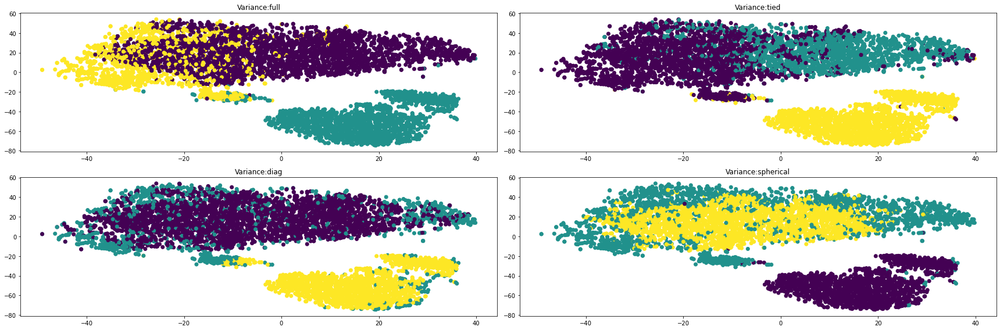

In [60]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 25].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 3, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

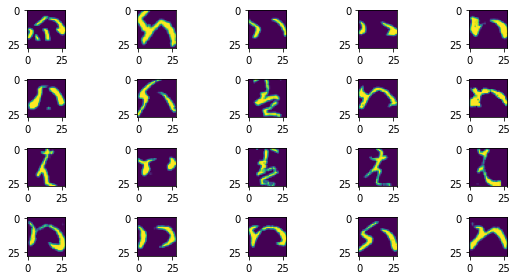

In [56]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 25].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

In [220]:

x = df_train.loc[df_train['label'] == 25].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


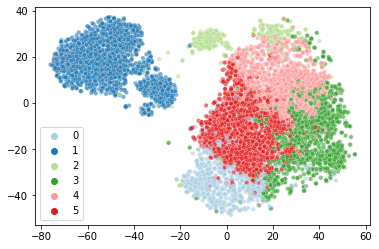

In [221]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 25].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

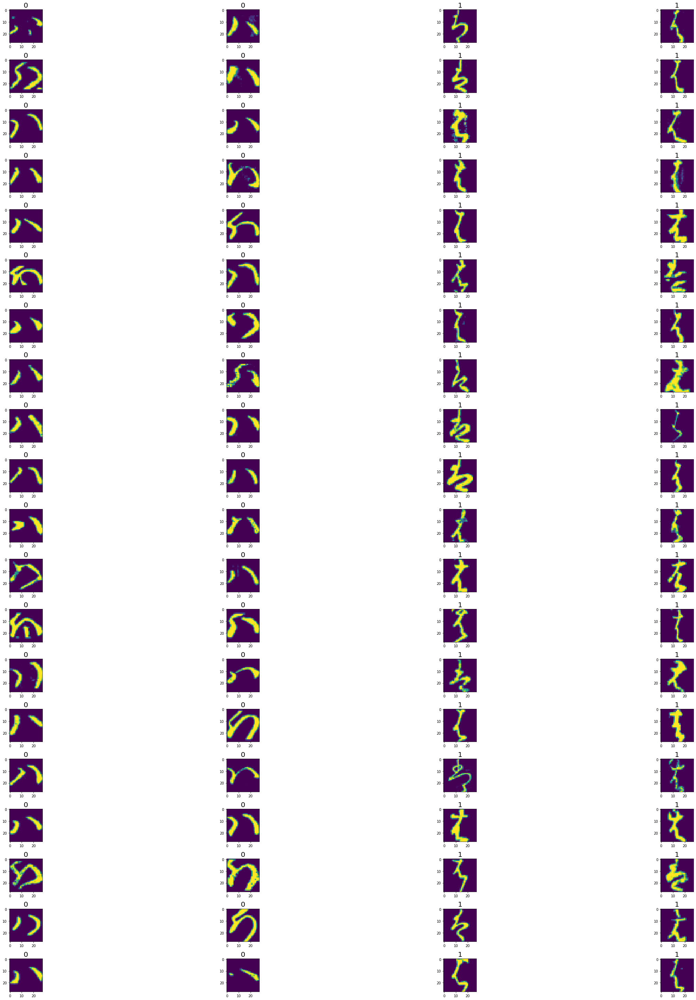

In [222]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_25 = df_train.loc[df_train['label'] == 25].copy(deep=True)
df_train_25["Style"] = 0

x = df_train_25.loc[df_train['label'] == 25].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 1 else 0 for i in ykm]

df_train_25.loc[df_train_25['label'] == 25, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_25.loc[df_train_25['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_25.loc[df_train_25['Style'] == 1].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
    
        

fig.tight_layout()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


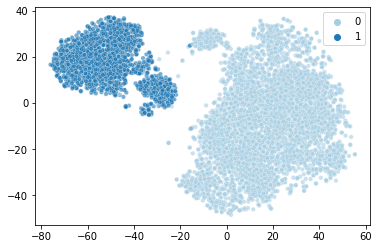

In [223]:
sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6, s=20)
plt.legend()

**Label 27**

Text(0.5, 1.0, 'Label:27')

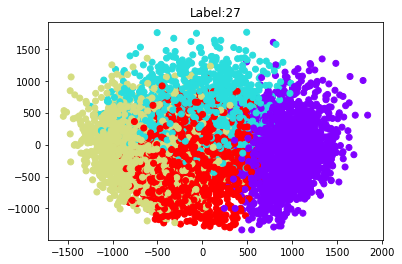

In [57]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 4)
x = df_train.loc[df_train['label'] == 27].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(27))

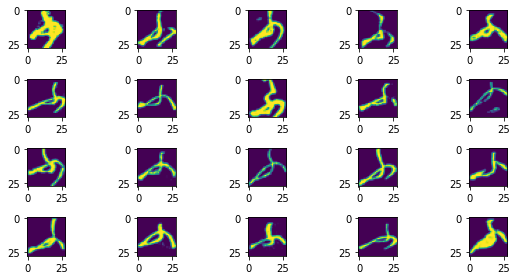

In [58]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 27].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

**Label 29**

Text(0.5, 1.0, 'Label:29')

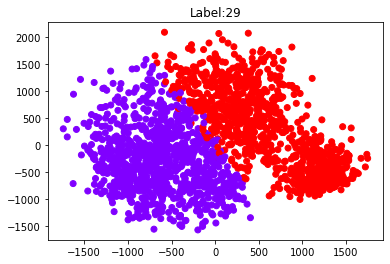

In [85]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 29].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(29))

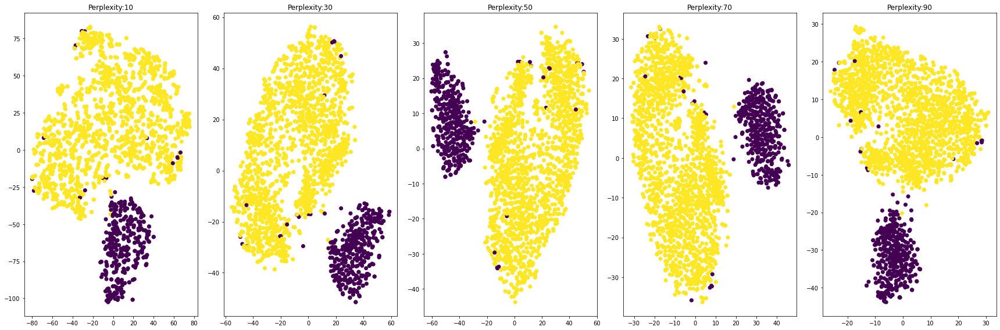

In [68]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 29].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

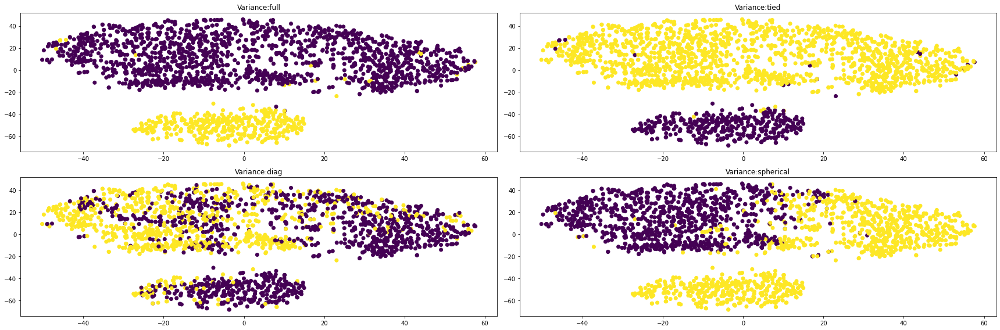

In [61]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 29].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 30, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

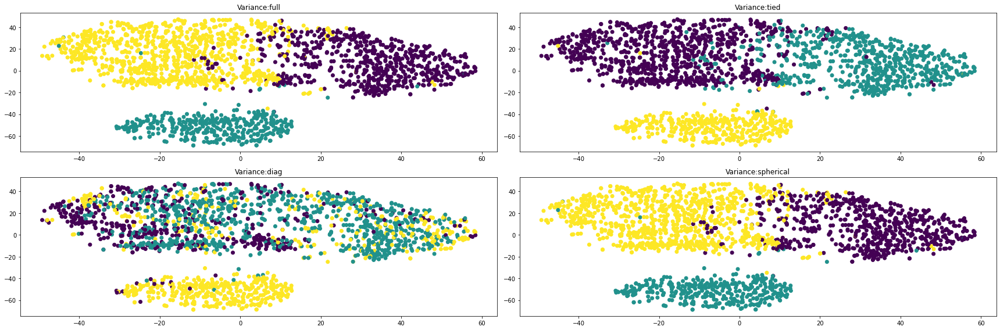

In [138]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 29].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 30, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 3, covariance_type = v, n_init = 50, max_iter=1000, tol=1e-6)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'Label:29')

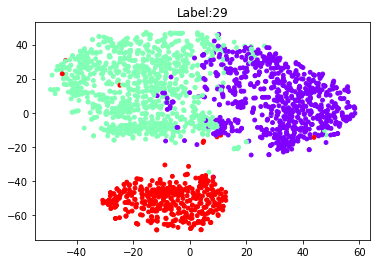

In [139]:

km = KMeans(n_clusters = 3, n_init = 50, max_iter = 1000, tol = 1e-7)
x = df_train.loc[df_train['label'] == 29].to_numpy()
ykm = km.fit_predict(x)
plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
plt.title('Label:' +str(29))

Text(0.5, 1.0, 'gaussian')

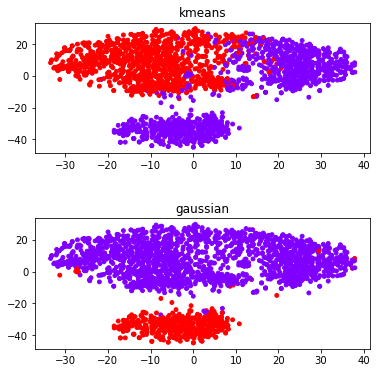

In [106]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 29].to_numpy()

km = KMeans(n_clusters = 2, n_init = 50, max_iter = 1000, tol = 1e-7)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow',s=15)
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

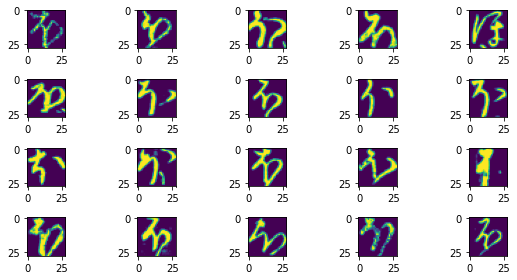

In [60]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 29].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

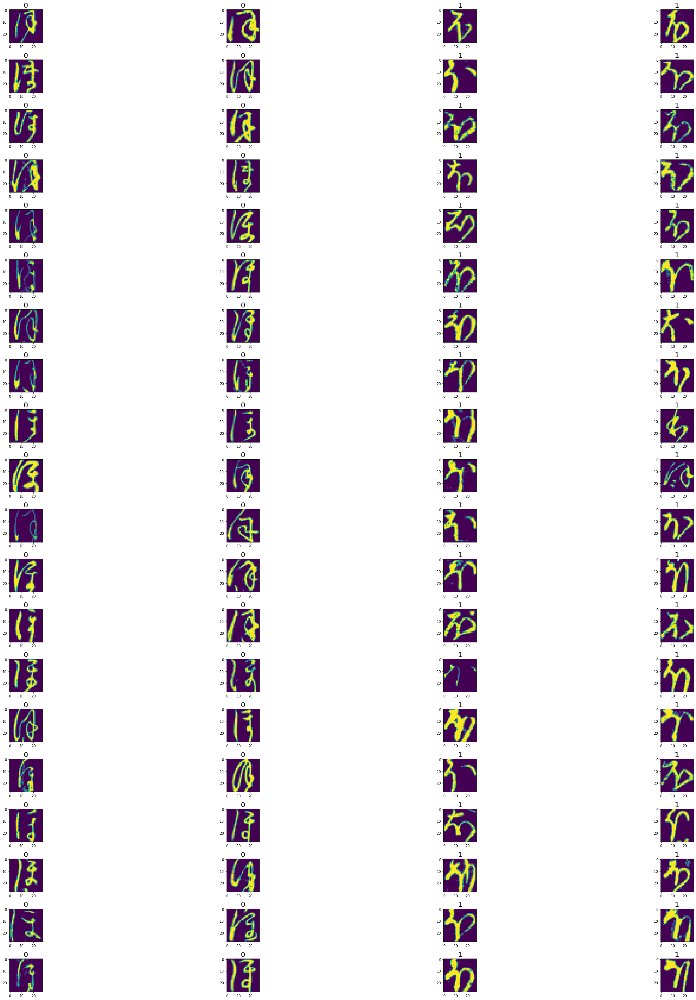

In [137]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_29 = df_train.loc[df_train['label'] == 29].copy(deep=True)
df_train_29["Style"] = 0

x = df_train_29.loc[df_train_29['label'] == 29].to_numpy()[:,1:785]

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

df_train_29.loc[df_train_29['label'] == 29, 'Style'] += ygm

fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_29.loc[df_train_29['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_29.loc[df_train_29['Style'] == 1].iloc[40:80].to_numpy()


for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

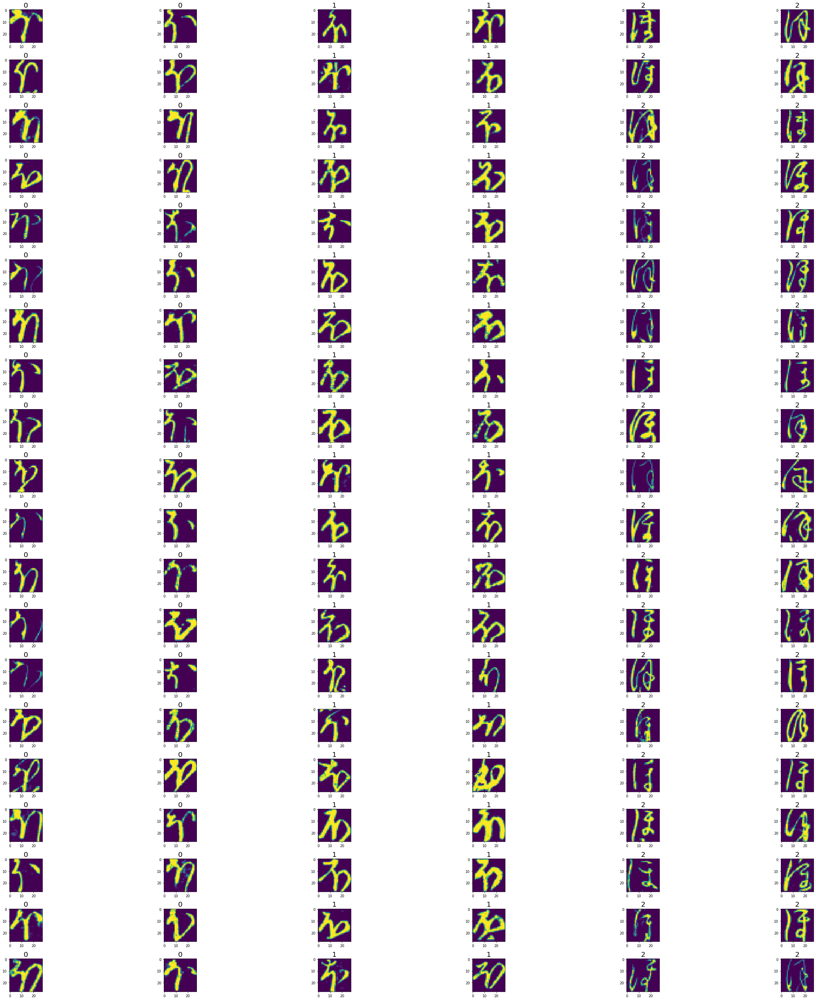

In [142]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_29 = df_train.loc[df_train['label'] == 29].copy(deep=True)
df_train_29["Style"] = 0

x = df_train_29.loc[df_train_29['label'] == 29].to_numpy()[:,1:785]

gm = GaussianMixture(n_components = 3, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

df_train_29.loc[df_train_29['label'] == 29, 'Style'] += ygm


fig, axs = plt.subplots(20, 6, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_29.loc[df_train_29['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_29.loc[df_train_29['Style'] == 1].iloc[40:80].to_numpy()
label2 = df_train_29.loc[df_train_29['Style'] == 2].iloc[40:80].to_numpy()



for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label2:
    axs[row, 4 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 4 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

In [224]:
x = df_train.loc[df_train['label'] == 29].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


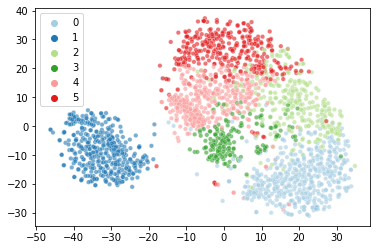

In [226]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 29].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6,palette='Paired', s=20)
plt.legend()

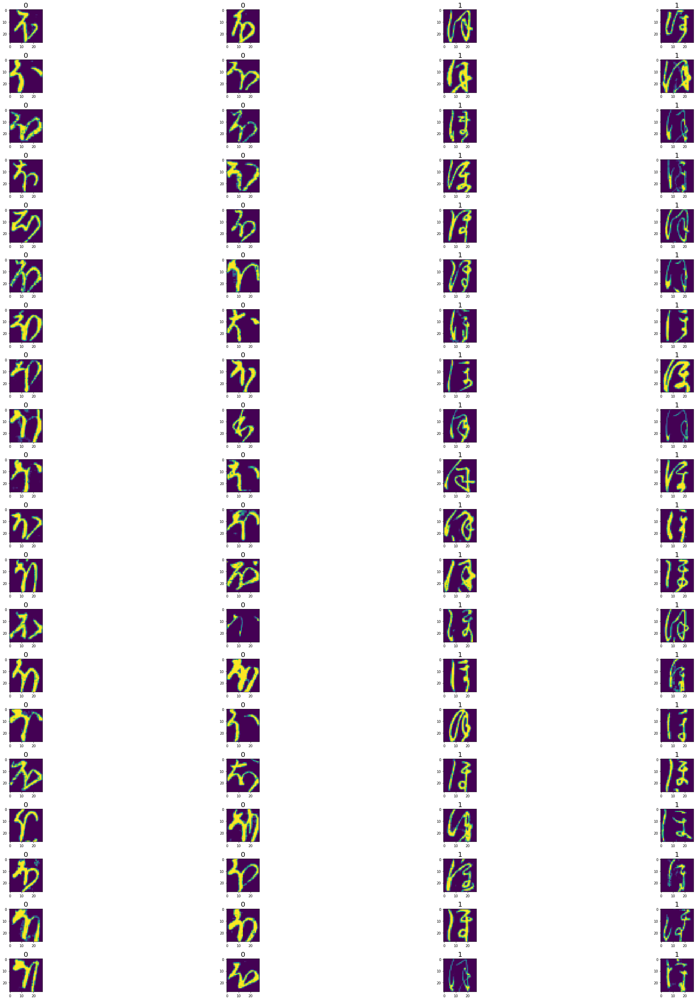

In [227]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_29 = df_train.loc[df_train['label'] == 29].copy(deep=True)
df_train_29["Style"] = 0

x = df_train_29.loc[df_train['label'] == 29].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 1 else 0 for i in ykm]

df_train_29.loc[df_train_29['label'] == 29, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_29.loc[df_train_29['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_29.loc[df_train_29['Style'] == 1].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
    
        

fig.tight_layout()

C:\Users\mstra\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


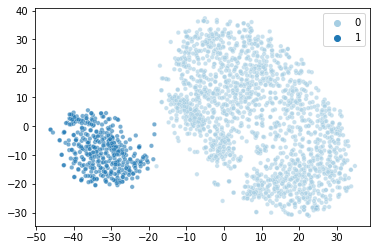

In [228]:
sns.scatterplot(X_tsne[:,0],X_tsne[:,1],hue=ykm, alpha=0.6, s=20)
plt.legend()

**Label 31**

Text(0.5, 1.0, 'Label:31')

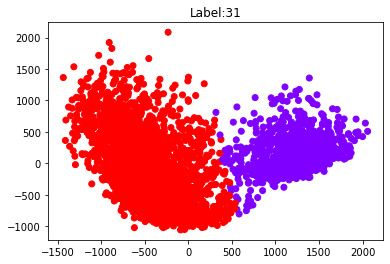

In [61]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 31].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(31))

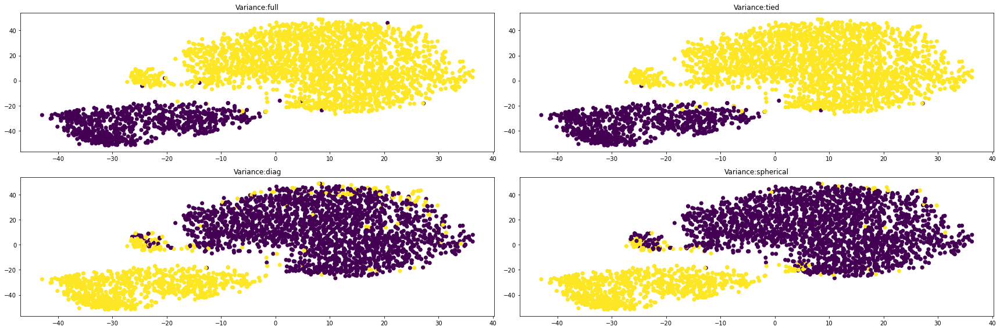

In [69]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 31].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'gaussian')

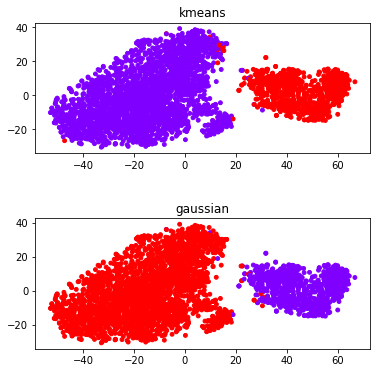

In [105]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 31].to_numpy()

km = KMeans(n_clusters = 2, n_init = 50, max_iter = 1000, tol = 1e-7)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow',s=15)
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

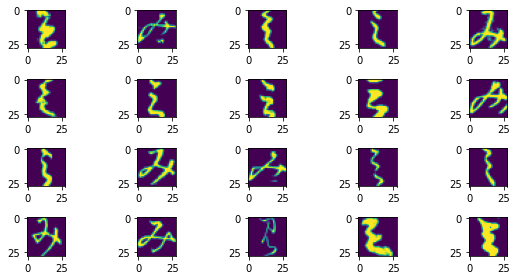

In [62]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 31].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

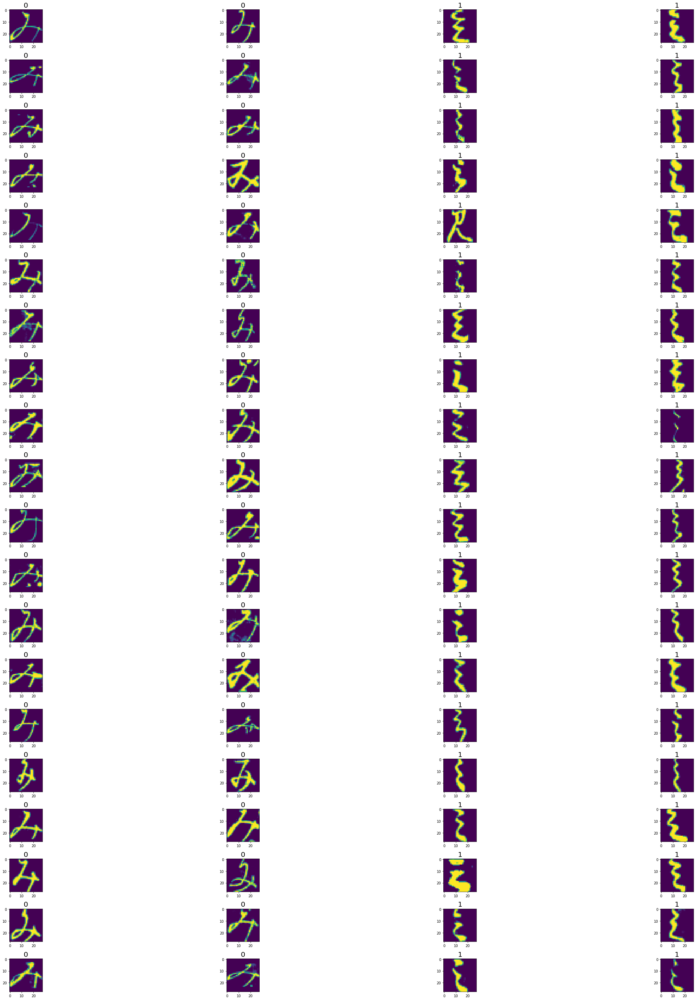

In [136]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_31 = df_train.loc[df_train['label'] == 31].copy(deep=True)
df_train_31["Style"] = 0

x = df_train_31.loc[df_train_31['label'] == 31].to_numpy()[:,1:785]

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

df_train_31.loc[df_train_31['label'] == 31, 'Style'] += ygm

fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_31.loc[df_train_31['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_31.loc[df_train_31['Style'] == 1].iloc[40:80].to_numpy()


for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

In [229]:
x = df_train.loc[df_train['label'] == 31].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

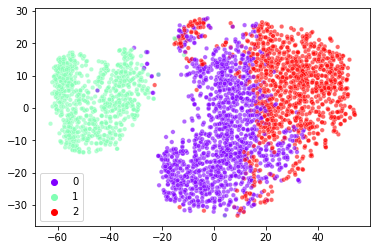

In [242]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 31].to_numpy()[:,1:785]

km = KMeans(n_clusters = 3, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6,palette='rainbow', s=20)
plt.legend()

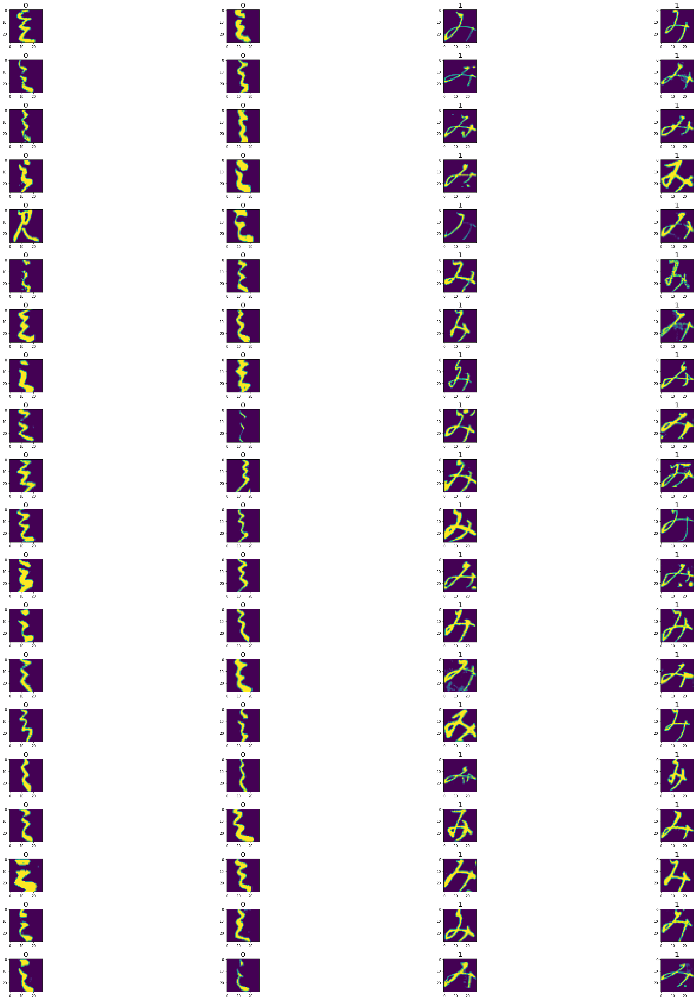

In [239]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_31 = df_train.loc[df_train['label'] == 31].copy(deep=True)
df_train_31["Style"] = 0

x = df_train_31.loc[df_train_31['label'] == 31].to_numpy()[:,1:785]

km = KMeans(n_clusters = 3, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 1 else 0 for i in ykm]

df_train_31.loc[df_train_31['label'] == 31, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_31.loc[df_train_31['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_31.loc[df_train_31['Style'] == 1].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
    
        

fig.tight_layout()

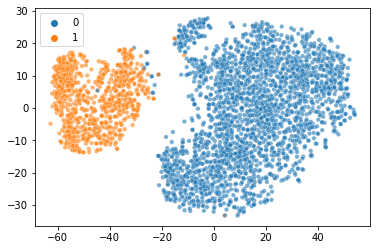

In [240]:
sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6, s=20)
plt.legend()

**Label 32**

Text(0.5, 1.0, 'Label:32')

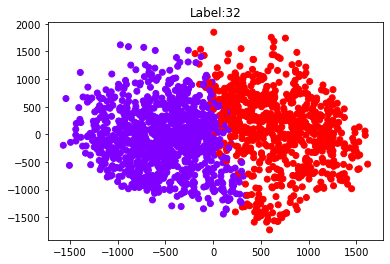

In [63]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 32].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(32))

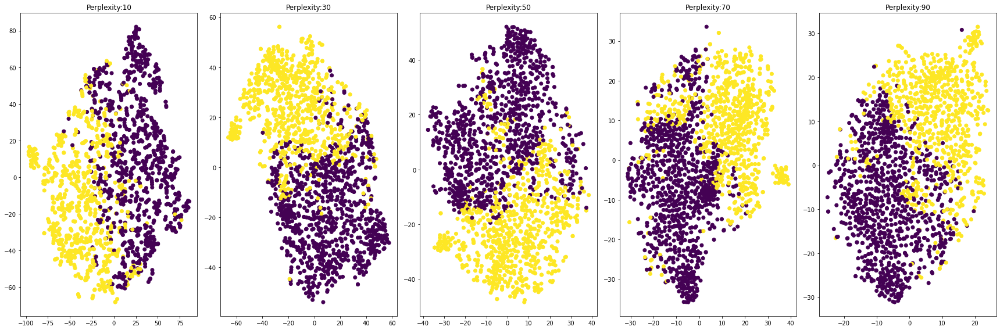

In [70]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 32].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

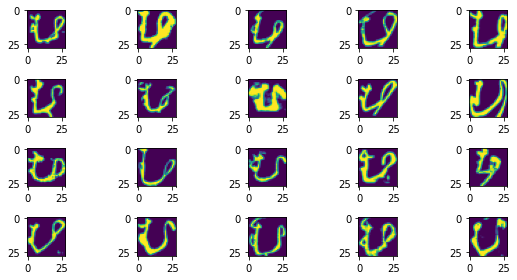

In [64]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 32].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

Text(0.5, 1.0, 'Label:33')

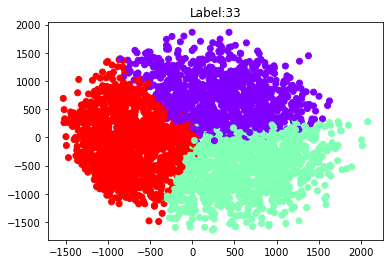

In [65]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 3)
x = df_train.loc[df_train['label'] == 33].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(33))

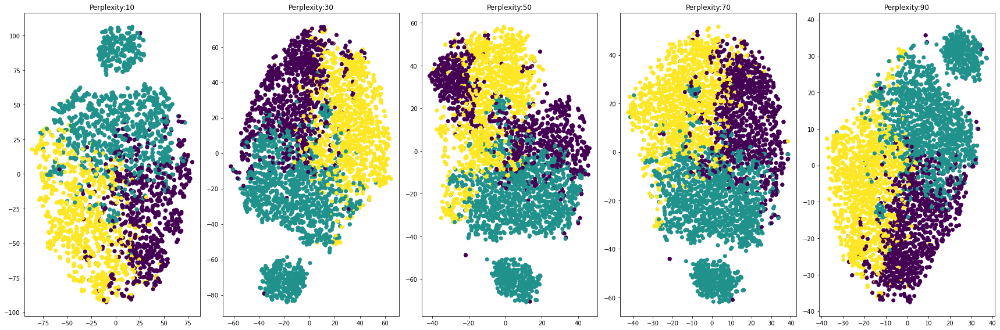

In [71]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 33].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 3,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

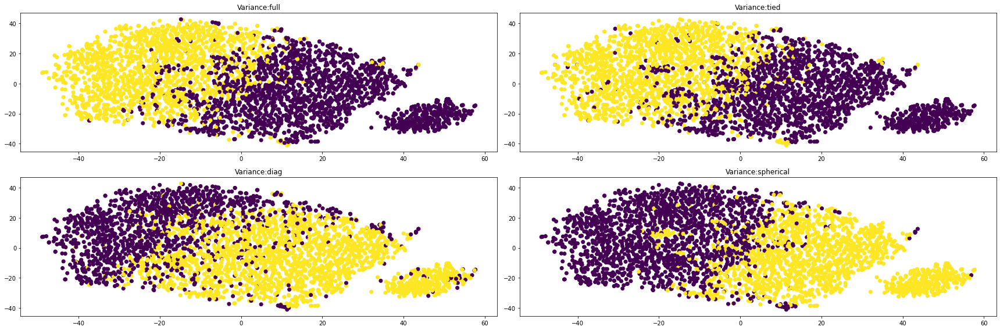

In [62]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 33].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

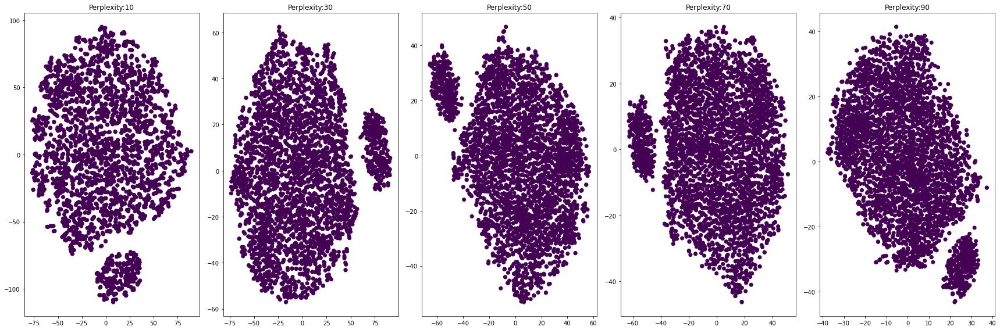

In [63]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 33].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

db = DBSCAN(eps=0.1)
ydb = db.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ydb)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

C:\Users\mstra\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


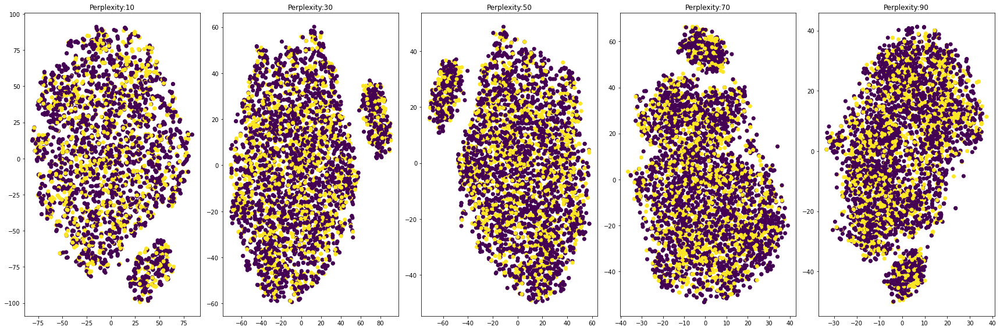

In [80]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from sklearn.cluster import SpectralClustering

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 33].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

sc = SpectralClustering(n_clusters = 2)
ysc = sc.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ysc)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

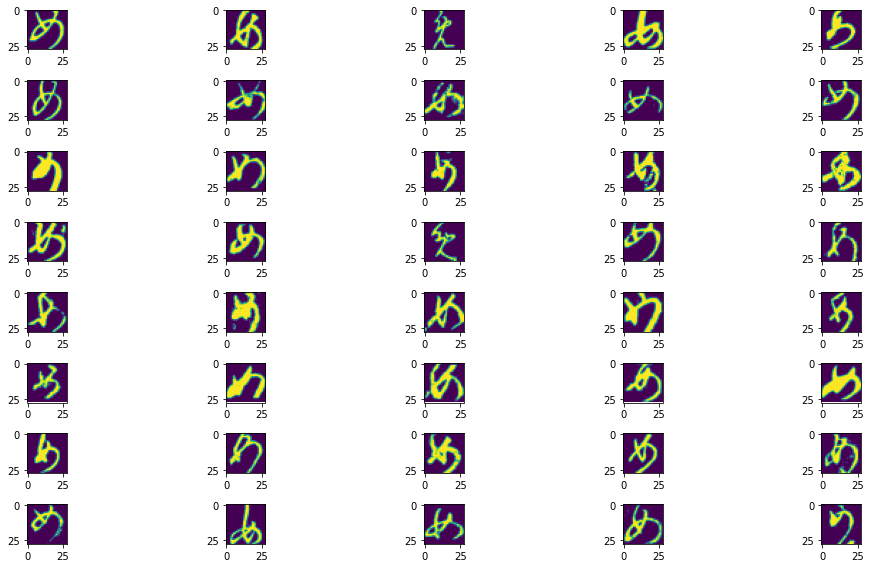

In [66]:
fig, axs = plt.subplots(8, 5, figsize=(15, 8))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 33].iloc[:40].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

In [29]:
from sklearn.manifold import TSNE

x = df_train.loc[df_train['label'] == 33].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 30, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

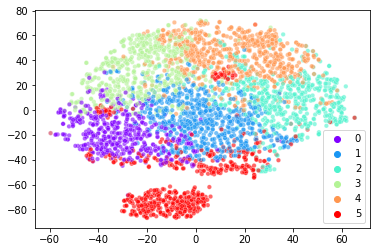

In [37]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 33].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6,palette='rainbow', s=20)
plt.legend()

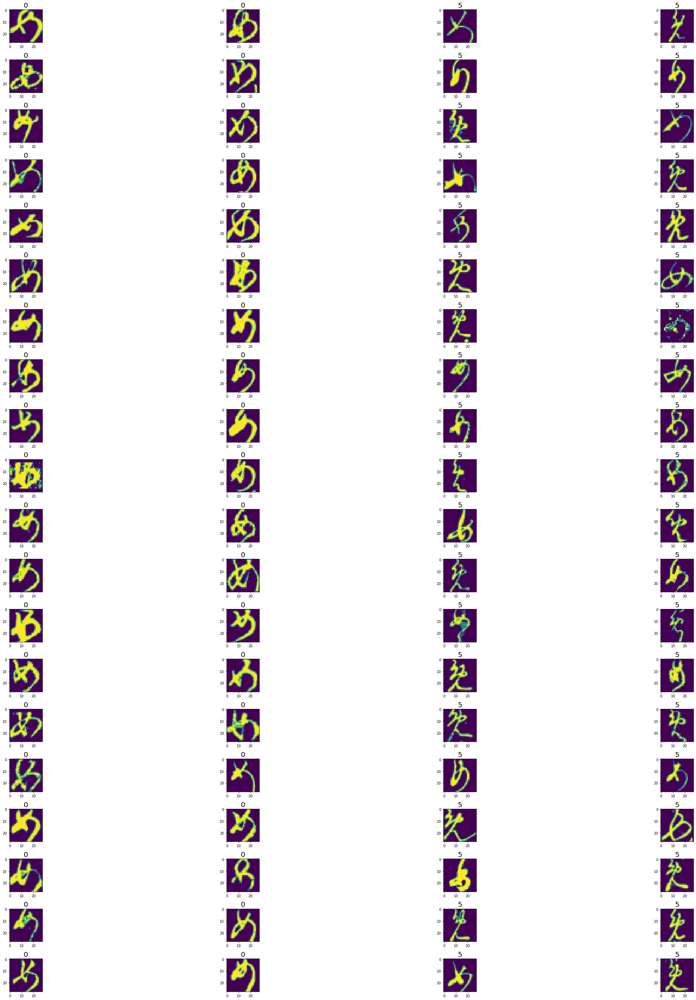

In [40]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_33 = df_train.loc[df_train['label'] == 33].copy(deep=True)
df_train_33["Style"] = 0

x = df_train_33.loc[df_train_33['label'] == 33].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 5 else 0 for i in ykm]

df_train_33.loc[df_train_33['label'] == 33, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_33.loc[df_train_33['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_33.loc[df_train_33['Style'] == 5].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
    
        

fig.tight_layout()

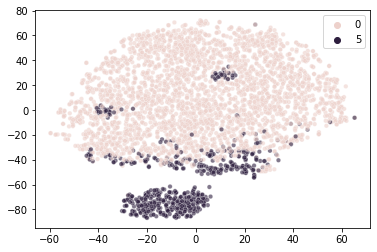

In [41]:
sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6, s=20)
plt.legend()

**Label 34**

Text(0.5, 1.0, 'Label:34')

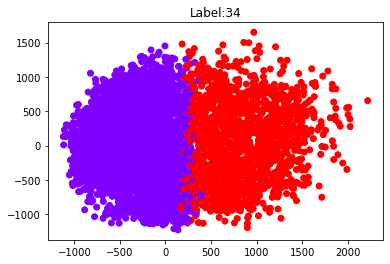

In [67]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 34].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(34))

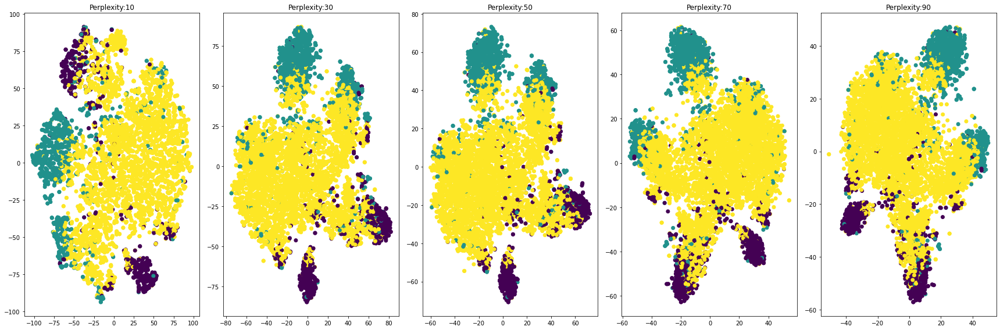

In [49]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 34].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 3,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

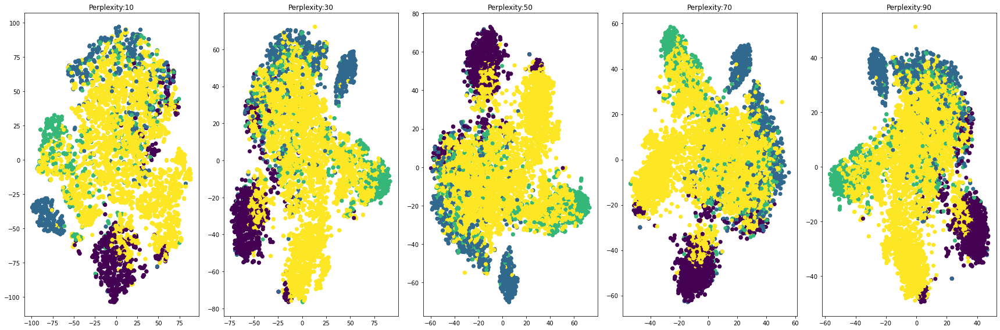

In [50]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 34].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 4,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

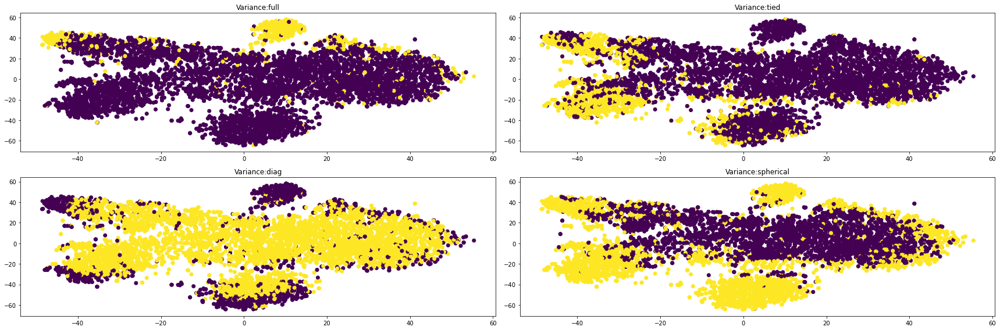

In [104]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 34].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 50, max_iter=1000,tol=1e-6)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

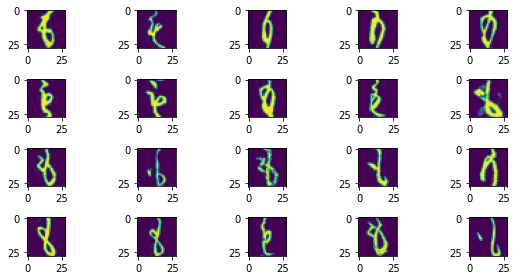

In [68]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 34].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

Text(0.5, 1.0, 'Label:36')

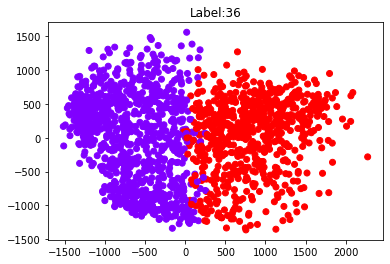

In [69]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 36].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(36))

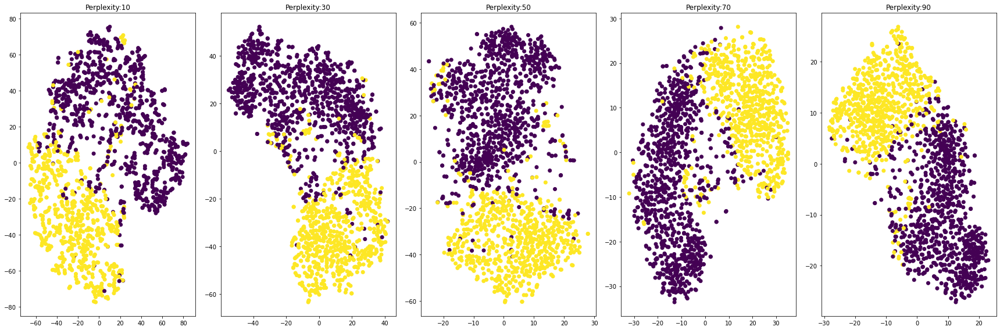

In [73]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 36].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

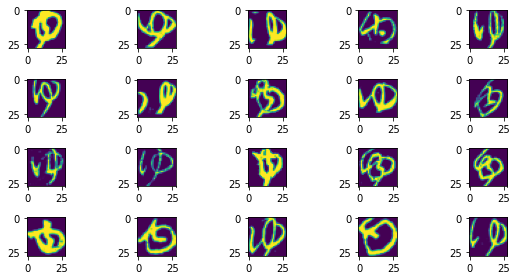

In [70]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 36].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

Text(0.5, 1.0, 'Label:38')

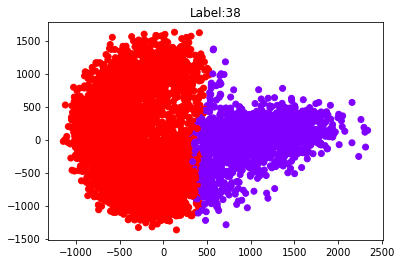

In [71]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 38].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(38))

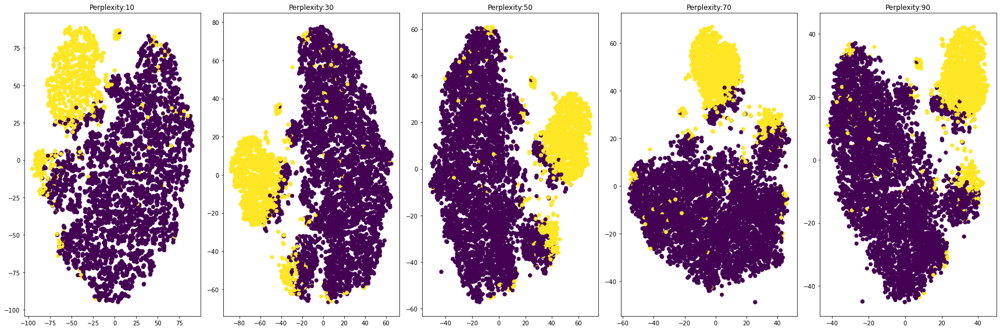

In [74]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 38].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

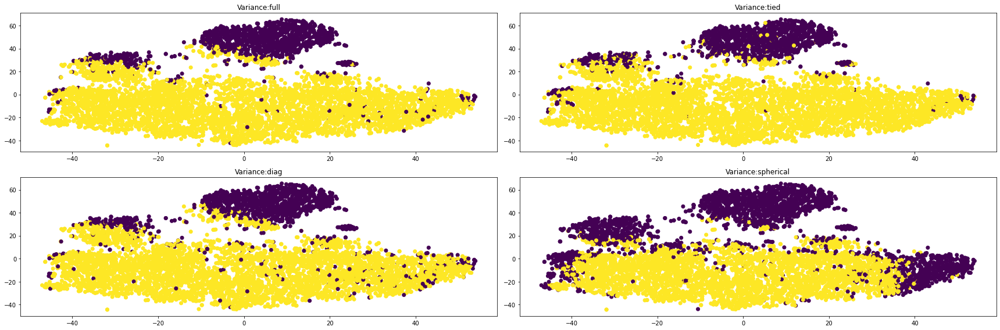

In [93]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 38].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 50, max_iter=1000,tol=1e-6)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

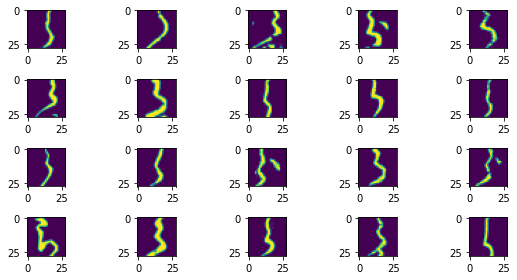

In [72]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 38].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

Text(0.5, 1.0, 'Label:39')

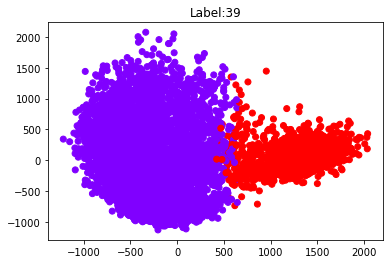

In [73]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 39].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(39))

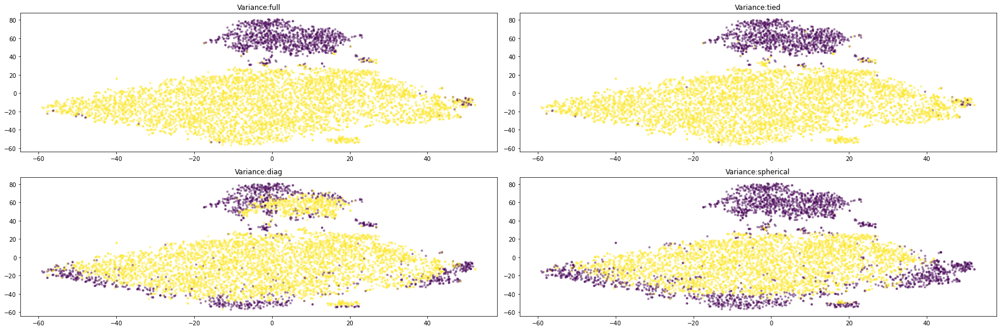

In [51]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 39].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'Label:39')

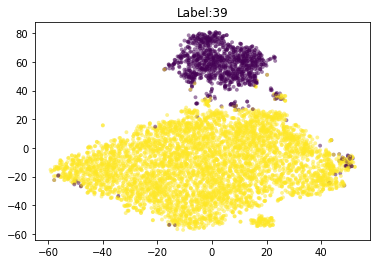

In [53]:

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 39].to_numpy()
ykm = km.fit_predict(x)
plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,s=15, edgecolor='none', alpha=0.5)
plt.title('Label:' +str(39))

Text(0.5, 1.0, 'gaussian')

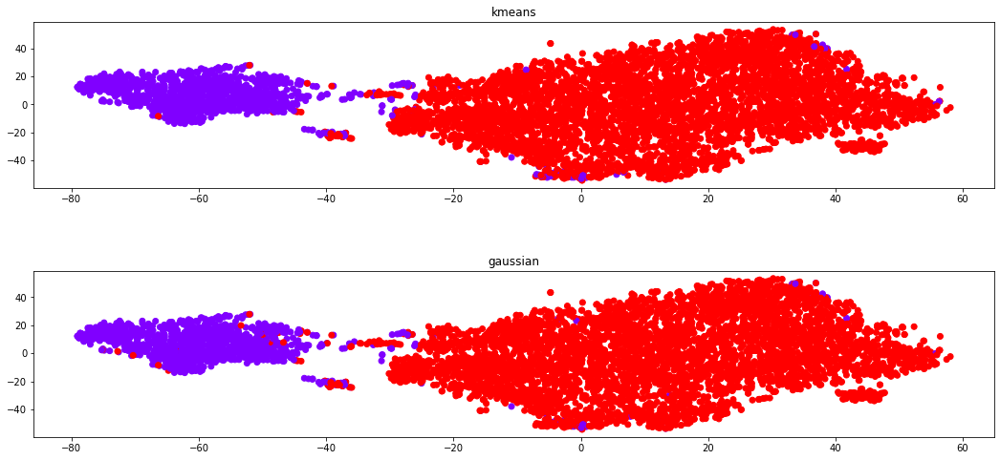

In [64]:
import hdbscan
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(18, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 39].to_numpy()

km = KMeans(n_clusters = 2)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 10)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow')
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow')
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

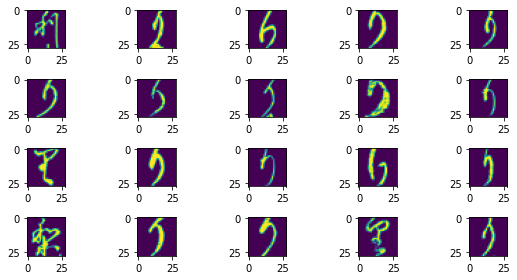

In [66]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 39].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

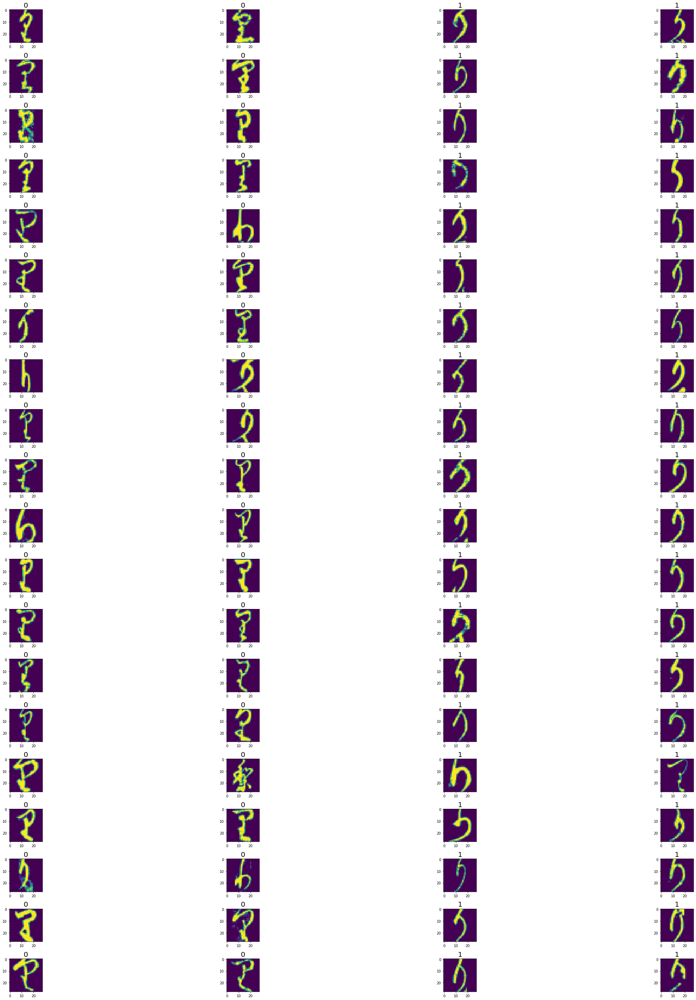

In [135]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_39 = df_train.loc[df_train['label'] == 39].copy(deep=True)
df_train_39["Style"] = 0

x = df_train_39.loc[df_train_39['label'] == 39].to_numpy()[:,1:785]

km = KMeans(n_clusters = 2, tol=1e-6, max_iter=1000, n_init = 50)
ykm = km.fit_predict(x)

df_train_39.loc[df_train_39['label'] == 39, 'Style'] += ykm

fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_39.loc[df_train_39['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_39.loc[df_train_39['Style'] == 1].iloc[40:80].to_numpy()


for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

In [42]:
from sklearn.manifold import TSNE

x = df_train.loc[df_train['label'] == 39].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 30, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

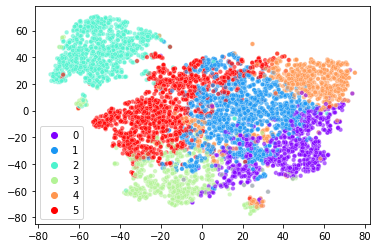

In [43]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 39].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6,palette='rainbow', s=20)
plt.legend()

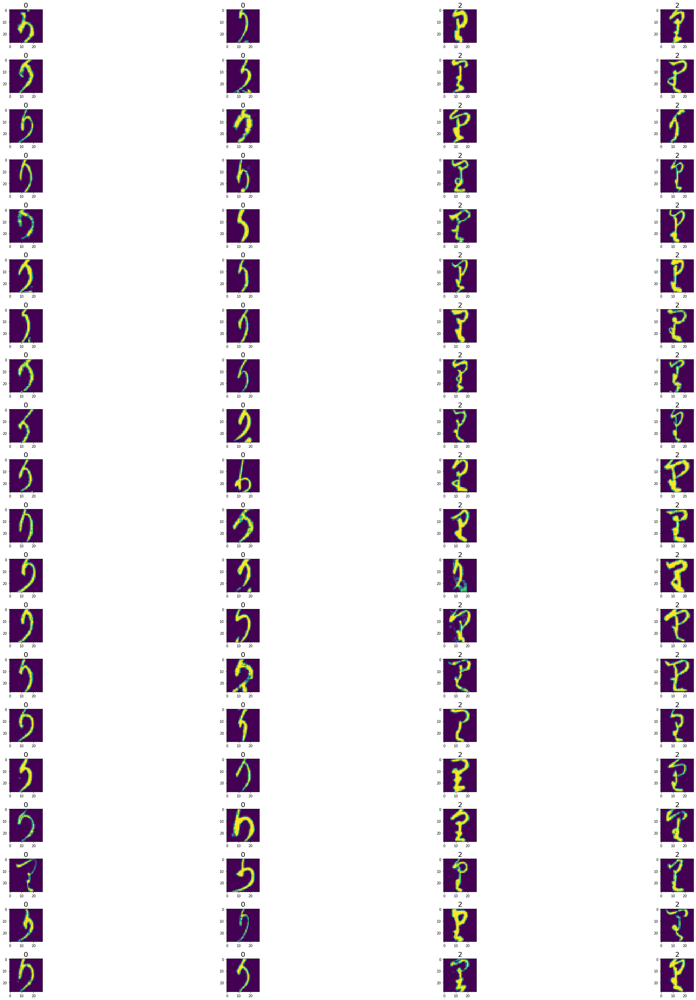

In [44]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_39 = df_train.loc[df_train['label'] == 39].copy(deep=True)
df_train_39["Style"] = 0

x = df_train_39.loc[df_train_39['label'] == 39].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 2 else 0 for i in ykm]

df_train_39.loc[df_train_39['label'] == 39, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_39.loc[df_train_39['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_39.loc[df_train_39['Style'] == 2].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
    
        

fig.tight_layout()

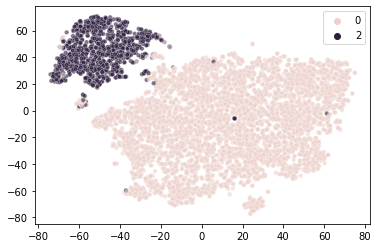

In [45]:
sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6, s=20)
plt.legend()

**Label 42**

Text(0.5, 1.0, 'Label:42')

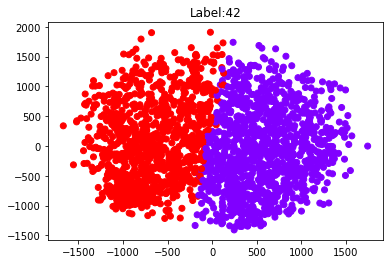

In [75]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 42].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(42))

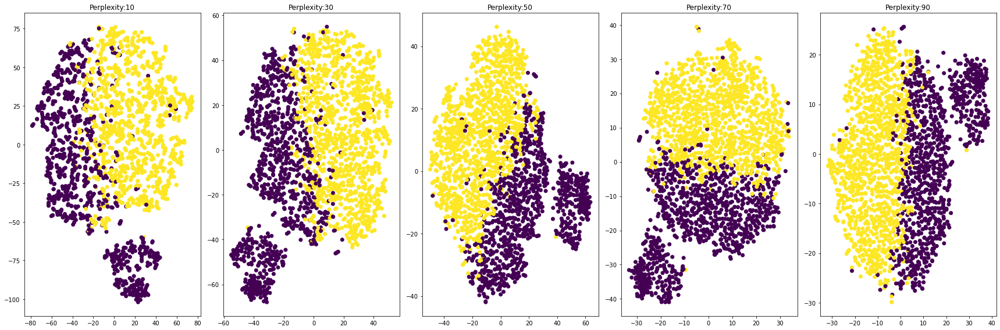

In [75]:
# test several perplexities
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 5, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 42].to_numpy() # next try on PCA

perp = [10,30,50,70,90]
col = 0
row = 0

gm = GaussianMixture(n_components = 2,covariance_type = 'full', n_init = 10)
ygm = gm.fit_predict(x)

for plx in perp:
    tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = plx, n_iter = 1000)
    X_tsne = tsne.fit_transform(x) 
    

    axs[row].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row].set_title('Perplexity:' +str(plx))
    row += 1

fig.tight_layout()

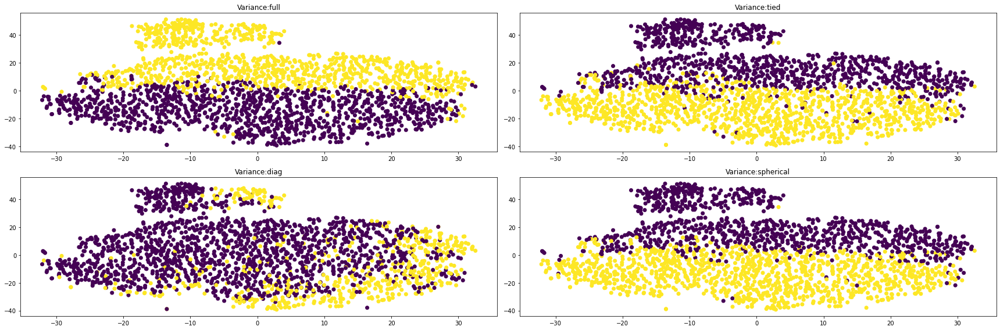

In [103]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 42].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 50, max_iter=1000,tol=1e-6)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'Label:42')

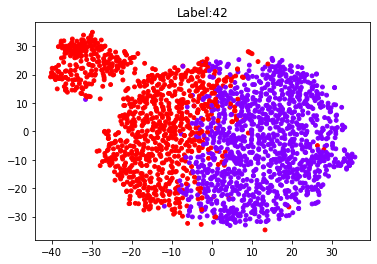

In [130]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

x = df_train.loc[df_train['label'] == 42].to_numpy() # next try on PCA


#tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
#X_tsne = tsne.fit_transform(x) 

km = KMeans(n_clusters = 2, n_init = 50, max_iter=1000, tol=1e-6)
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
plt.title('Label:' +str(42))

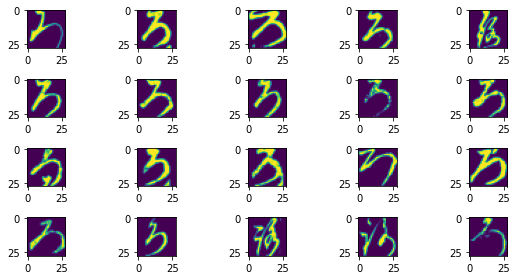

In [76]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 42].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

In [46]:
from sklearn.manifold import TSNE

x = df_train.loc[df_train['label'] == 42].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 30, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

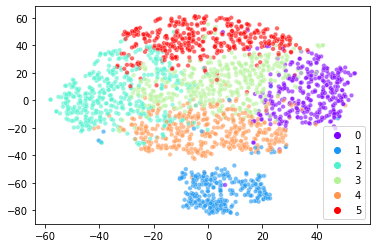

In [47]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 42].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6,palette='rainbow', s=20)
plt.legend()

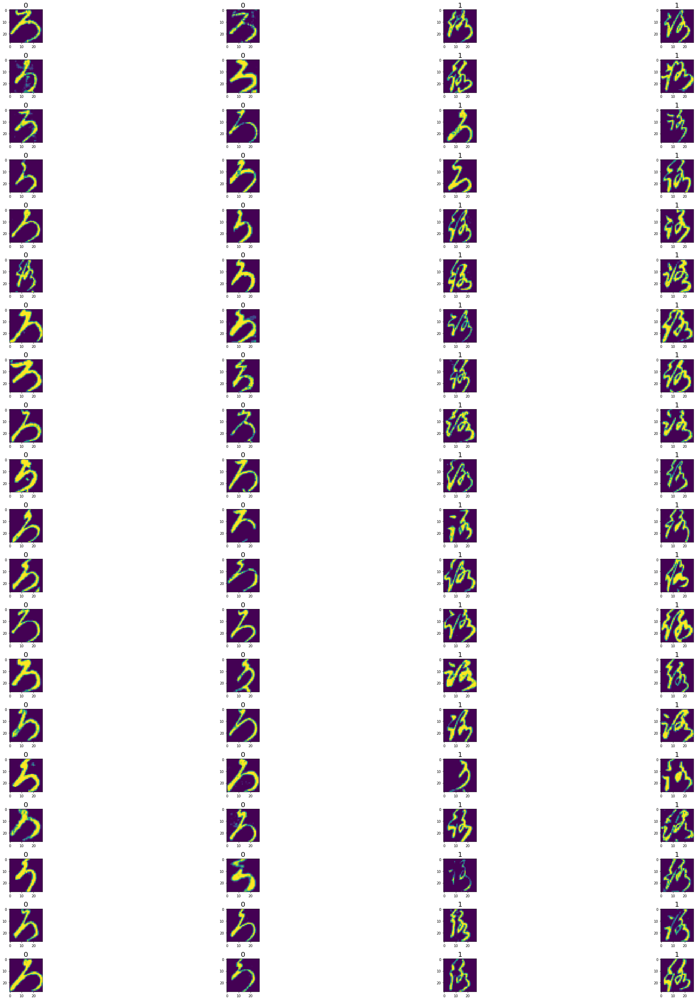

In [48]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_42 = df_train.loc[df_train['label'] == 42].copy(deep=True)
df_train_42["Style"] = 0

x = df_train_42.loc[df_train_42['label'] == 42].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 1 else 0 for i in ykm]

df_train_42.loc[df_train_42['label'] == 42, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_42.loc[df_train_42['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_42.loc[df_train_42['Style'] == 1].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
    
        

fig.tight_layout()

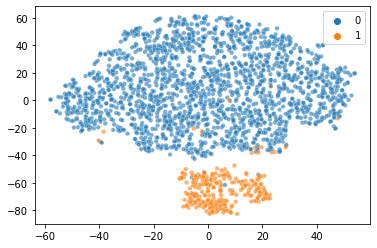

In [49]:
sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6, s=20)
plt.legend()

**Label 43**

Text(0.5, 1.0, 'Label:43')

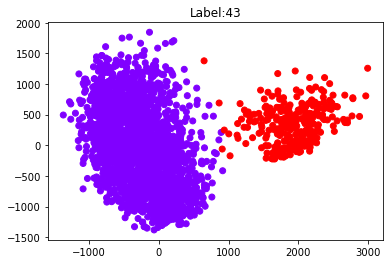

In [77]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 43].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(43))

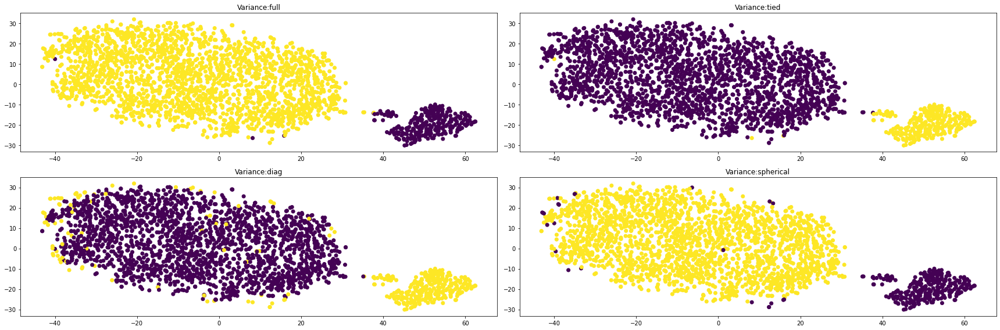

In [76]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 43].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 10)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'Label:43')

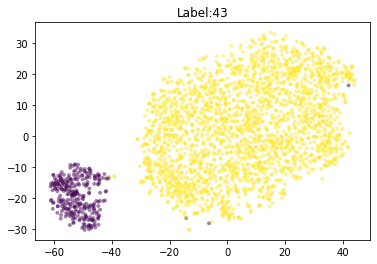

In [55]:

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 43].to_numpy()
ykm = km.fit_predict(x)
plt.scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,s=15, edgecolor='none', alpha=0.5)
plt.title('Label:' +str(43))

Text(0.5, 1.0, 'gaussian')

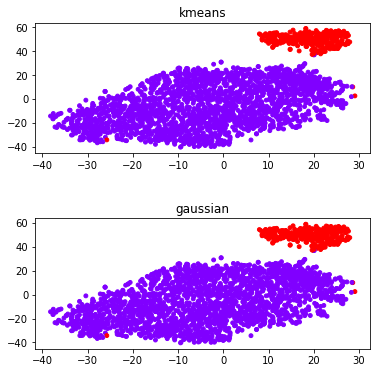

In [100]:
import hdbscan
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 43].to_numpy()

km = KMeans(n_clusters = 2)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 10)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow',s=15)
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

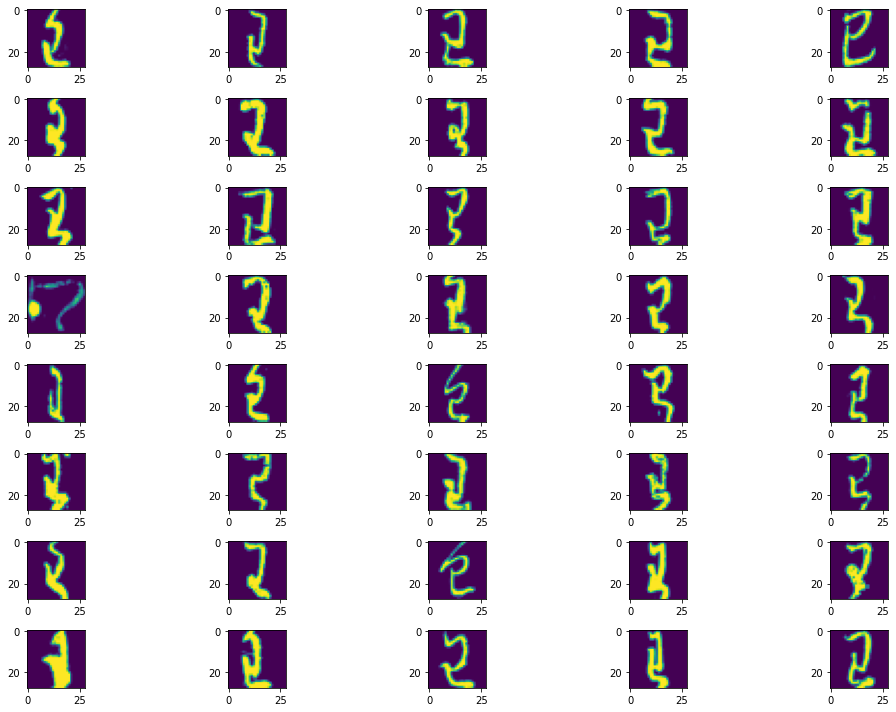

In [78]:
fig, axs = plt.subplots(8, 5, figsize=(15, 10))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 43].iloc[:40].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

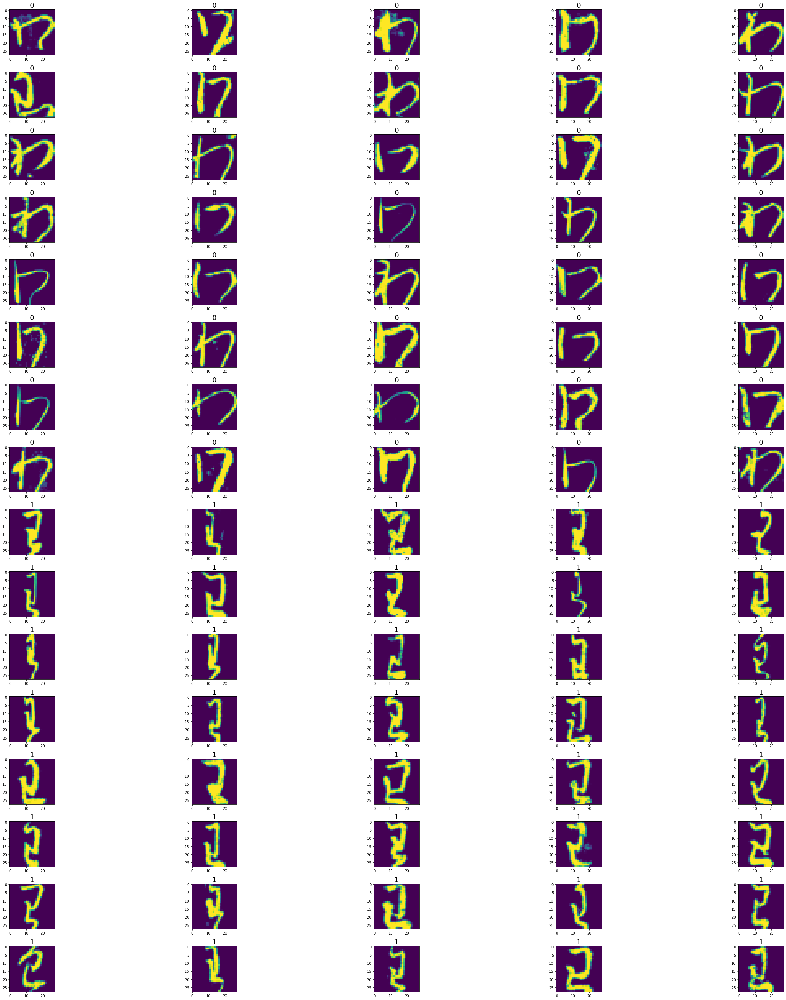

In [126]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_43 = df_train.loc[df_train['label'] == 43].copy(deep=True)
df_train_43["Style"] = 0

x = df_train_43.loc[df_train_43['label'] == 43].to_numpy()[:,1:785]

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-5, max_iter=1000, n_init = 10)
ygm = gm.fit_predict(x)

df_train_43.loc[df_train_43['label'] == 43, 'Style'] += ygm

fig, axs = plt.subplots(16, 5, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_43.loc[df_train_43['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_43.loc[df_train_43['Style'] == 1].iloc[40:80].to_numpy()


for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

for image in label1:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1


fig.tight_layout()

In [51]:
from sklearn.manifold import TSNE

x = df_train.loc[df_train['label'] == 43].to_numpy()[:,1:785]

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 30, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

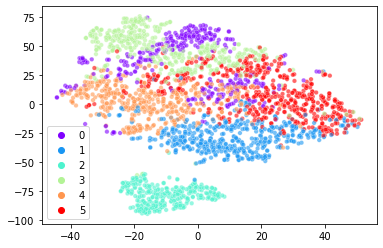

In [52]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
import seaborn as sns


x = df_train.loc[df_train['label'] == 43].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
ykm = km.fit_predict(x)


sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6,palette='rainbow', s=20)
plt.legend()

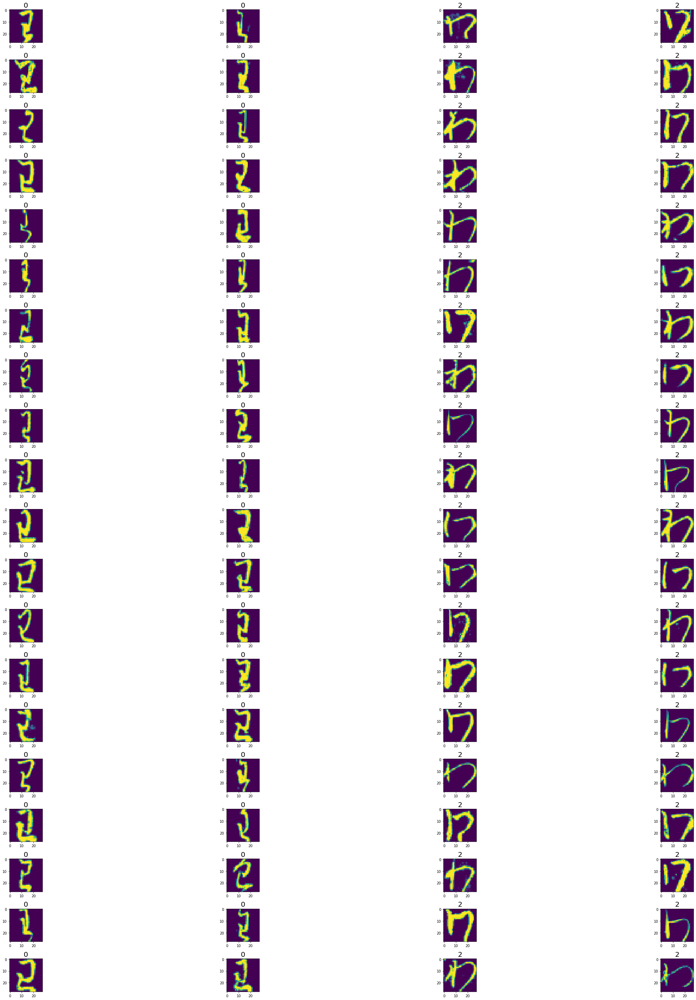

In [53]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

df_train_43 = df_train.loc[df_train['label'] == 43].copy(deep=True)
df_train_43["Style"] = 0

x = df_train_43.loc[df_train_43['label'] == 43].to_numpy()[:,1:785]

km = KMeans(n_clusters = 6, tol=1e-7, max_iter=5000, n_init = 50, random_state=419)

ykm = km.fit_predict(x)
ykm = [i if i == 2 else 0 for i in ykm]

df_train_43.loc[df_train_43['label'] == 43, 'Style'] += ykm


fig, axs = plt.subplots(20, 4, figsize=(40, 40))


col = 0
row = 0

label0 = df_train_43.loc[df_train_43['Style'] == 0].iloc[40:80].to_numpy()
label1 = df_train_43.loc[df_train_43['Style'] == 2].iloc[40:80].to_numpy()

for image in label0:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]),fontdict={'fontsize' : 20})
                            
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
        
row = 0

for image in label1:
    axs[row, 2 + col].imshow(image[1:785,].reshape(28,28))
    axs[row, 2 + col].set_title(str(image[785]),fontdict={'fontsize' : 20})

    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1
    
        

fig.tight_layout()

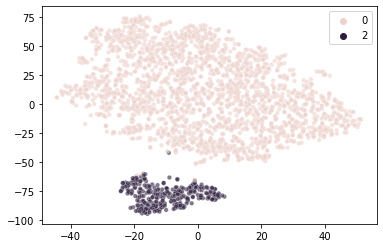

In [54]:
sns.scatterplot(x = X_tsne[:,0], y = X_tsne[:,1],hue=ykm, alpha=0.6, s=20)
plt.legend()

**Label 48**

Text(0.5, 1.0, 'Label:48')

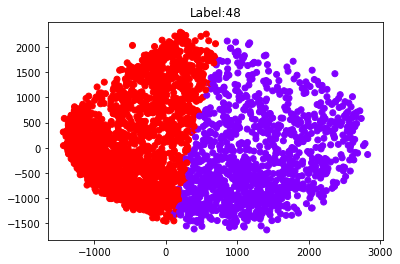

In [79]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 48].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(48))

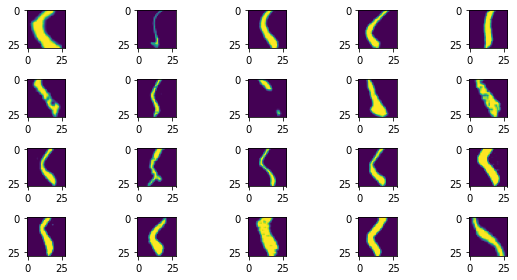

In [80]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 48].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

**Label 46**

Text(0.5, 1.0, 'Label:46')

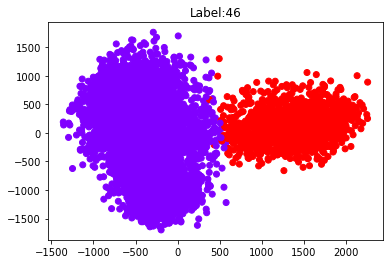

In [62]:
pca = PCA(n_components=2)

km = KMeans(n_clusters = 2)
x = df_train.loc[df_train['label'] == 46].to_numpy()
xpca = pca.fit_transform(x)
ykm = km.fit_predict(x)
plt.scatter(xpca[:,0],xpca[:,1],c=ykm,cmap='rainbow')
plt.title('Label:' +str(46))

In [63]:
ykm.shape

(5997,)

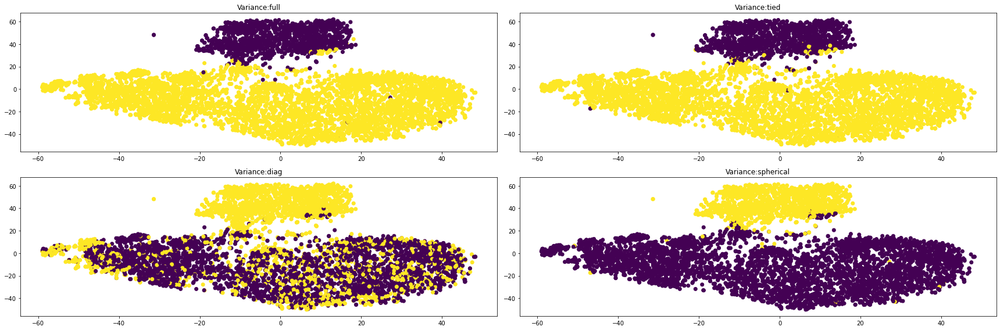

In [99]:
# compare GM variance parameters to isolate w/ minimal cluster mixture
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(24, 8))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 46].to_numpy() # next try on PCA

#pca = PCA(n_components=0.7)
#xpca = pca.fit_transform(x)

var = ['full', 'tied', 'diag', 'spherical']
col = 0
row = 0
tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

for v in var:
    gm = GaussianMixture(n_components = 2, covariance_type = v, n_init = 50,max_iter=1000,tol=1e-6)
    ygm = gm.fit_predict(x)

    axs[row,col].scatter(X_tsne[:, 0], X_tsne[:, 1],c=ygm)
    axs[row, col].set_title('Variance:' +str(v))
                                
    col += 1                       
    if col % 2 == 0:
        col = 0
        row +=1


fig.tight_layout()

Text(0.5, 1.0, 'gaussian')

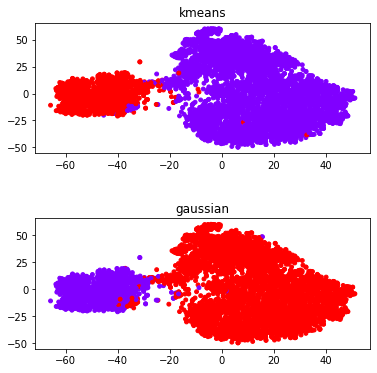

In [102]:
import hdbscan
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(2, figsize=(6, 6))
fig.subplots_adjust(hspace = 0.5, wspace=.3)

x = df_train.loc[df_train['label'] == 46].to_numpy()

km = KMeans(n_clusters = 2,n_init=50,tol=1e-6, max_iter=1000)
ykm = km.fit_predict(x)

gm = GaussianMixture(n_components = 2, covariance_type = 'tied', tol=1e-6, max_iter=1000, n_init = 50)
ygm = gm.fit_predict(x)

tsne = TSNE(n_components = 2, n_jobs = -1, perplexity = 70, n_iter = 1000)
X_tsne = tsne.fit_transform(x) 

axs[0].scatter(X_tsne[:,0],X_tsne[:,1],c=ykm,cmap='rainbow',s=15)
axs[1].scatter(X_tsne[:,0],X_tsne[:,1],c=ygm,cmap='rainbow',s=15)
axs[0].set_title('kmeans')
axs[1].set_title('gaussian')

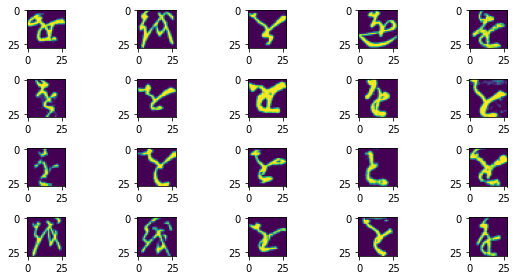

In [77]:
fig, axs = plt.subplots(4, 5, figsize=(8, 4))

col = 0
row = 0

label = df_train.loc[df_train['label'] == 46].iloc[:20].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:,].reshape(28,28))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

**Making writting styles machine-learnable**

Stratey:
- Add writting style variable 

We have to handle number of styles differently for each character:

In [23]:
# Define two dictionaries: one with the cluster label of the stye and the other the number of clusters to feed knn 

clusters_by_kmeans_slim = {
    0 : 0,
    1 : 0,
    2 : 0,
    3 : 0,
    4 : 0,
    5 : 4,
    6 : 0,
    7 : 0,
    8 : 0,
    9 : 0,
    10 : 0,
    11 : 0,
    12 : 0,
    13 : 0,
    14 : 0,
    15 : 0,
    16 : 0,
    17 : 0,
    18 : 0,
    19 : 0,
    20 : 0,
    21 : 7,
    22 : 0,
    23 : 6,
    24 : 0,
    25 : 6,
    26 : 0,
    27 : 0,
    28 : 0,
    29 : 6,
    30 : 0,
    31 : 3,
    32 : 0,
    33 : 0,
    34 : 0,
    35 : 0,
    36 : 0,
    37 : 0,
    38 : 0,
    39 : 6,
    40 : 0,
    41 : 0,
    42 : 6,
    43 : 6,
    44 : 0,
    45 : 0,
    46 : 0,
    47 : 0,
    48 : 0
}

cluster_label_slim = {
    5 : 3,
    21 : 5,
    23 : 1,
    25 : 1,
    29 : 1,
    31 : 1,
    39 : 2,
    42 : 1,
    43 : 2
}

**Style Label**


Here we use the above dictionary to cluster each label of the dataset according to the parameters determined in the prior analysis.

In [24]:
df_train_var = df_train.copy(deep=True)
df_train_var["Style"] = 0

df_test_var = df_test.copy(deep=True)
df_test_var["Style"] = 0

In [25]:
from sklearn.cluster import KMeans
#train clusters
new_label = int(0)

for label in clusters_by_kmeans_slim:
    x = df_train_var.loc[df_train_var['label'] == label].to_numpy()[:,1:785]
    
    if clusters_by_kmeans_slim[label] != 0:
        km = KMeans(n_clusters = clusters_by_kmeans_slim[label], tol=1e-7, max_iter=5000, n_init = 50, random_state=419)
        ykm = km.fit_predict(x)
        ykm = [1 if i == cluster_label_slim[label] else 0 for i in ykm]
        ykm = np.asarray(ykm)
    else:
        ykm = np.zeros(df_train_var.loc[df_train_var['label'] == label].shape[0], dtype = int)
    
    ykm.astype(int)
    ykm += new_label
    df_train_var.loc[df_train_var['label'] == label, 'Style'] += (ykm)
    print(len(np.unique(ykm)),label)
    new_label += len(np.unique(ykm))

1 0
1 1
1 2
1 3
1 4
2 5
1 6
1 7
1 8
1 9
1 10
1 11
1 12
1 13
1 14
1 15
1 16
1 17
1 18
1 19
1 20
2 21
1 22
2 23
1 24
2 25
1 26
1 27
1 28
2 29
1 30
2 31
1 32
1 33
1 34
1 35
1 36
1 37
1 38
2 39
1 40
1 41
2 42
2 43
1 44
1 45
1 46
1 47
1 48


In [26]:
df_train_var["Style"] = df_train_var["Style"].astype("category")
df_test_var["Style"] = df_test_var["Style"].astype("category")

In [27]:
for x in range(49):    
    print(x,df_train_var.loc[df_train_var['label'] == x]['Style'].unique())

0 [0]
Categories (1, int64): [0]
1 [1]
Categories (1, int64): [1]
2 [2]
Categories (1, int64): [2]
3 [3]
Categories (1, int64): [3]
4 [4]
Categories (1, int64): [4]
5 [5, 6]
Categories (2, int64): [5, 6]
6 [7]
Categories (1, int64): [7]
7 [8]
Categories (1, int64): [8]
8 [9]
Categories (1, int64): [9]
9 [10]
Categories (1, int64): [10]
10 [11]
Categories (1, int64): [11]
11 [12]
Categories (1, int64): [12]
12 [13]
Categories (1, int64): [13]
13 [14]
Categories (1, int64): [14]
14 [15]
Categories (1, int64): [15]
15 [16]
Categories (1, int64): [16]
16 [17]
Categories (1, int64): [17]
17 [18]
Categories (1, int64): [18]
18 [19]
Categories (1, int64): [19]
19 [20]
Categories (1, int64): [20]
20 [21]
Categories (1, int64): [21]
21 [22, 23]
Categories (2, int64): [22, 23]
22 [24]
Categories (1, int64): [24]
23 [25, 26]
Categories (2, int64): [25, 26]
24 [27]
Categories (1, int64): [27]
25 [28, 29]
Categories (2, int64): [28, 29]
26 [30]
Categories (1, int64): [30]
27 [31]
Categories (1, int

In [28]:
df_train_var.loc[df_train_var['label'] == 12]

,label,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,Style
22,12,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,13
57,12,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,13
129,12,0,0,0,0,0,0,0,0,0,...,43,0,0,0,0,0,0,0,0,13
159,12,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,13
271,12,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
232140,12,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,13
232283,12,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,13
232285,12,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,13
232294,12,0,0,0,0,0,0,0,0,0,...,186,216,61,0,0,0,0,0,0,13


In [ ]:
fig, axs = plt.subplots(8, 5, figsize=(15, 10))

col = 0
row = 0

label = df_train_var.loc[df_train['label'] == 21].iloc[40:80].to_numpy()

for image in label:
    axs[row, col].imshow(image[1:785,].reshape(28,28))
    axs[row, col].set_title(str(image[785]))
                            
    col += 1                       
    if col % 5 == 0:
        col = 0
        row +=1

fig.tight_layout()

We see the styles are well distinguished in this example (label 21)

**New variable for each style**

In [30]:
# Drop label column and use styles as label!

df_train_lab = df_train_var.copy(deep=True)
df_train_lab = df_train_lab.loc[:, df_train_lab.columns != 'label']

df_test_lab = df_test_var.copy(deep=True)
df_test_lab = df_test_lab.loc[:, df_test_lab.columns != 'label']

In [31]:
label_frq = df_train_lab['Style'].value_counts()
label_frq

20    6000
35    6000
7     6000
8     6000
47    6000
21    5999
27    5999
48    5999
16    5999
40    5999
10    5998
19    5998
18    5998
13    5998
12    5998
41    5998
43    5998
2     5998
44    5997
1     5997
55    5997
0     5996
11    5995
32    5995
31    5995
4     5993
56    5991
30    5128
22    5105
45    4941
9     4708
5     4397
28    4325
14    4164
15    3867
57    3521
39    3392
17    2564
36    2281
51    2107
24    2063
25    1996
49    1876
38    1718
29    1674
33    1602
6     1601
42    1598
46    1059
23     894
37     777
3      777
26     455
53     417
54     392
34     391
52     289
50     263
Name: Style, dtype: int64

In [32]:
# unique styles:

styles = len(df_train_lab['Style'].unique())
styles

58

**PyCaret Modeling**

In [27]:
# Benchmark: no styles identified

from pycaret.classification import *

setup(data = df_train, target = 'label') # Prepare data for pycaret modeling
best_model = compare_models(include = ['dt','rf','lr','ridge','svm','nb','ada','knn']) # Compare a few classification models

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
knn,K Neighbors Classifier,0.8908,0.9777,0.8723,0.8963,0.8913,0.8882,0.8883,2512.7810
rf,Random Forest Classifier,0.8675,0.9923,0.8360,0.8691,0.8665,0.8643,0.8643,98.2100
lr,Logistic Regression,0.6596,0.9623,0.6365,0.6568,0.6567,0.6514,0.6514,614.9400
dt,Decision Tree Classifier,0.5849,0.7876,0.5453,0.5848,0.5844,0.5749,0.5749,35.4530
ridge,Ridge Classifier,0.5116,0.0000,0.4401,0.5473,0.4828,0.4992,0.5005,3.9430
svm,SVM - Linear Kernel,0.4981,0.0000,0.4742,0.5785,0.4978,0.4860,0.4887,815.9740
nb,Naive Bayes,0.3513,0.8019,0.3754,0.4478,0.3389,0.3364,0.3447,11.3280
ada,Ada Boost Classifier,0.3182,0.8723,0.2988,0.3138,0.2944,0.3019,0.3034,79.2010


Observe the highest accuracy model is K-nearest neighbors at 89.08%

In [33]:
# Models trained on style-differentiated data

from pycaret.classification import *

setup(data = df_train_lab, target = 'Style') # Prepare data for pycaret modeling
best_model = compare_models(include = ['rf','lr', 'knn']) # Compare a few classification models

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
knn,K Neighbors Classifier,0.8912,0.9779,0.8565,0.8968,0.8916,0.8887,0.8888,2583.7590
rf,Random Forest Classifier,0.8680,0.9926,0.8040,0.8703,0.8664,0.8649,0.8650,112.1540
lr,Logistic Regression,0.6762,0.9682,0.6407,0.6750,0.6744,0.6688,0.6688,751.6070


There is a very slight improvement using the differentiated styles, but it may not be significant.